# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x, y), dim=1)
    #### END CODE HERE ####
    return combined

In [7]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [11]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda:0'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


/home/amichay/.local/lib/python3.8/site-packages/torchvision/datasets/mnist.py:469: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [15]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [16]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [17]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.4580090798139573, discriminator loss: 0.24122311967238783


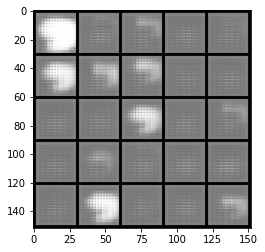

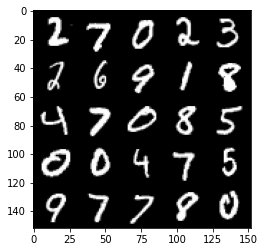

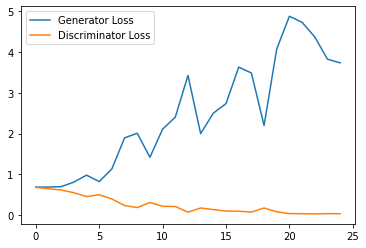

Step 1000: Generator loss: 4.337948237895966, discriminator loss: 0.037048805319704115


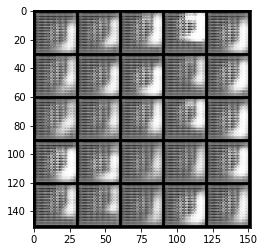

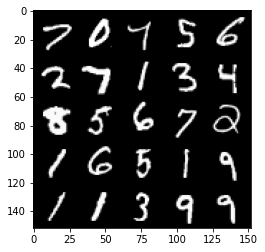

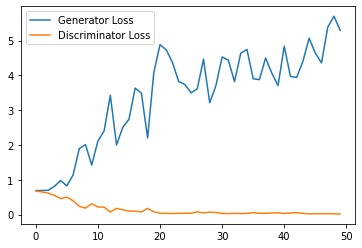

Step 1500: Generator loss: 5.566761947631836, discriminator loss: 0.024250663643702864


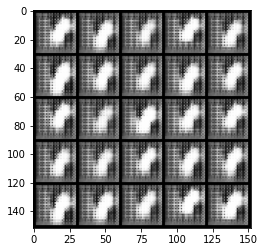

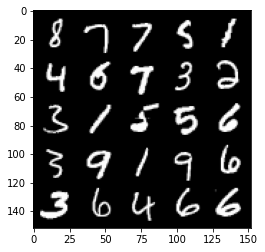

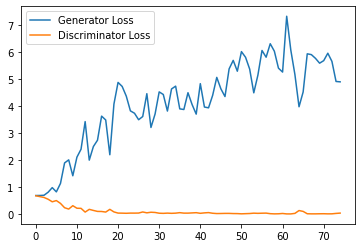

Step 2000: Generator loss: 5.674715469837189, discriminator loss: 0.022992738495580853


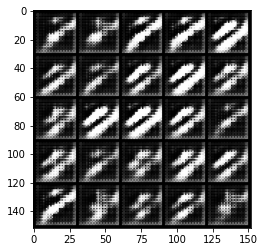

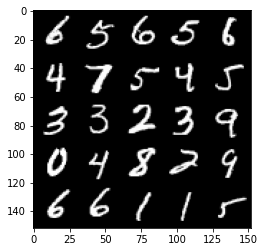

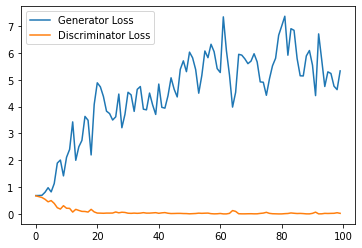

Step 2500: Generator loss: 5.021510813236237, discriminator loss: 0.031058112747967243


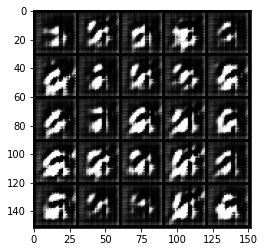

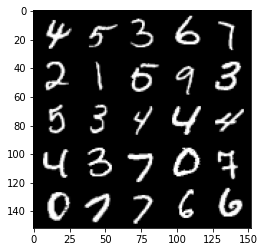

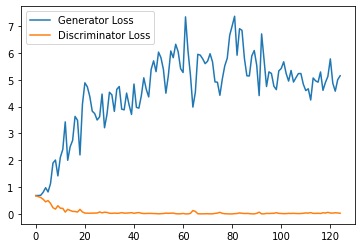

Step 3000: Generator loss: 4.089187932491303, discriminator loss: 0.07603411192074418


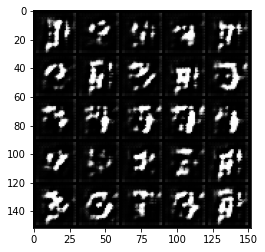

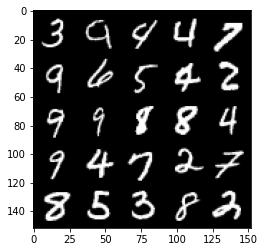

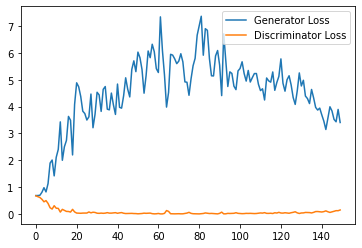

Step 3500: Generator loss: 3.0401260635852814, discriminator loss: 0.20840560138225556


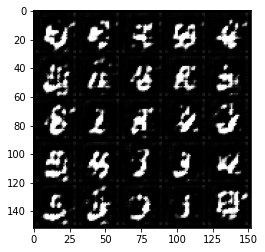

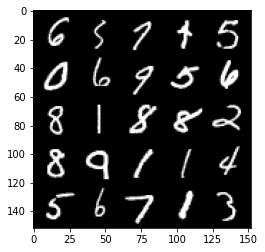

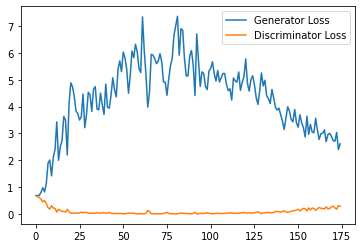

Step 4000: Generator loss: 2.493210851192474, discriminator loss: 0.23424956189095975


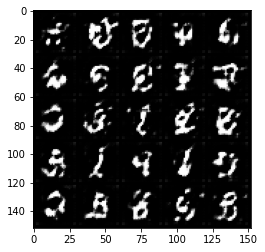

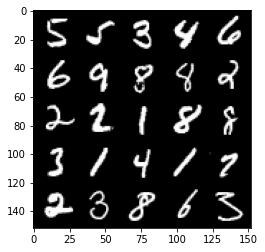

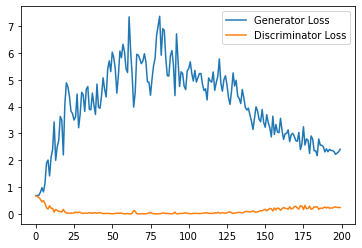

Step 4500: Generator loss: 2.4006855540275573, discriminator loss: 0.2729044121801853


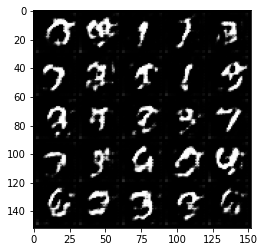

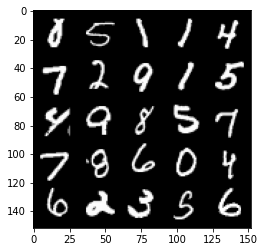

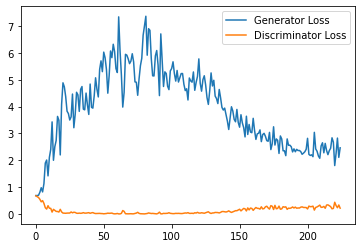

Step 5000: Generator loss: 2.1321438262462618, discriminator loss: 0.2990333430469036


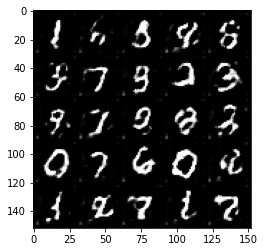

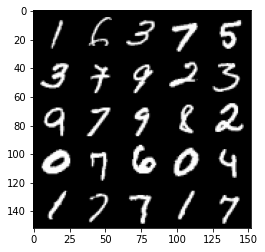

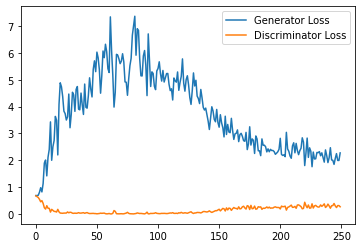

Step 5500: Generator loss: 1.9597372965812683, discriminator loss: 0.3365906689763069


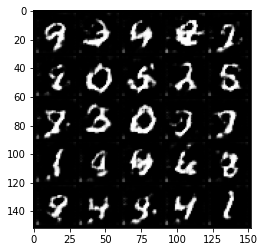

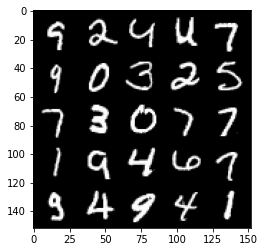

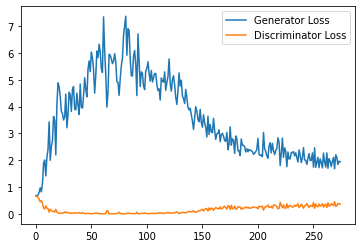

Step 6000: Generator loss: 1.9341019263267518, discriminator loss: 0.36171614077687264


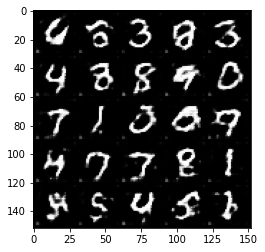

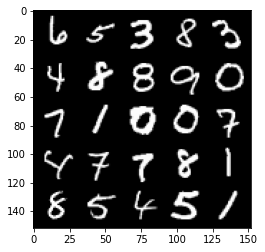

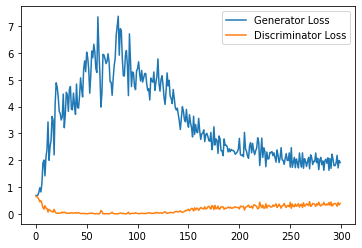

Step 6500: Generator loss: 1.8164020459651946, discriminator loss: 0.3959309900999069


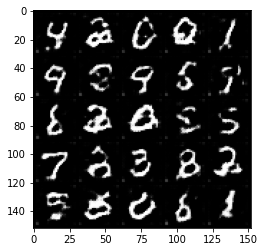

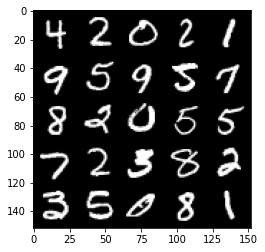

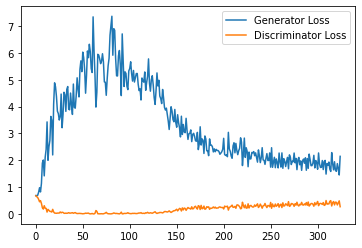

Step 7000: Generator loss: 1.666793049812317, discriminator loss: 0.42167424991726876


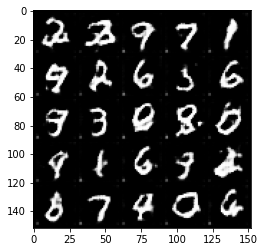

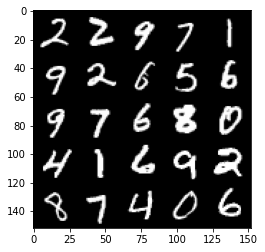

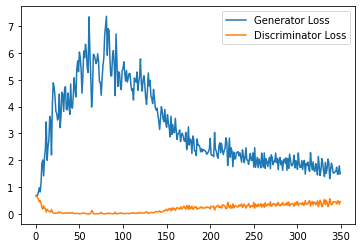

Step 7500: Generator loss: 1.6083937295675277, discriminator loss: 0.43209392529726026


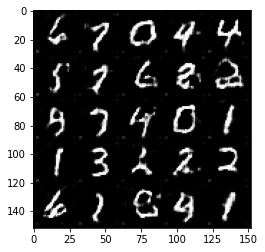

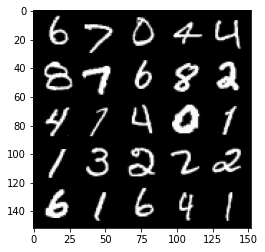

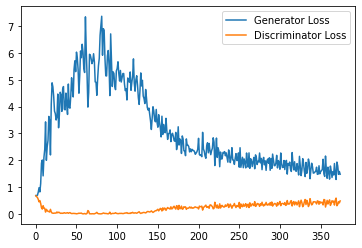

Step 8000: Generator loss: 1.6692876627445221, discriminator loss: 0.4398715704083443


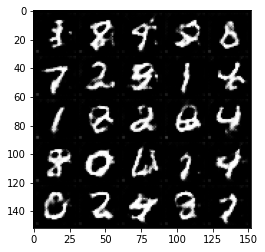

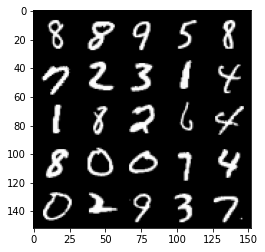

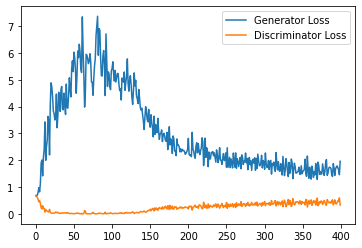

Step 8500: Generator loss: 1.538309834241867, discriminator loss: 0.4793410939574242


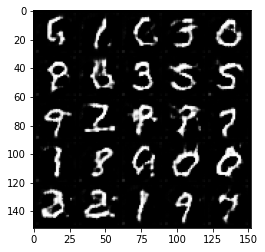

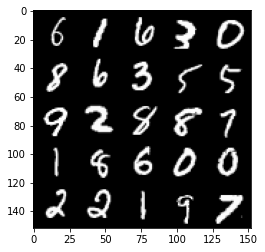

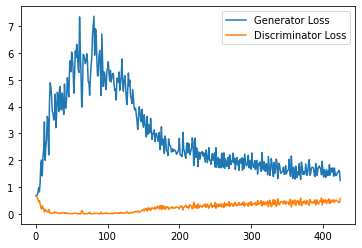

Step 9000: Generator loss: 1.5954280630350113, discriminator loss: 0.46128572544455526


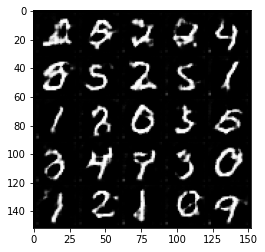

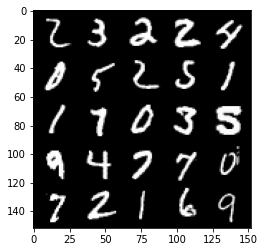

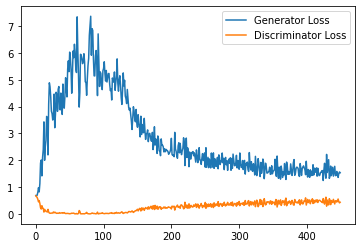

Step 9500: Generator loss: 1.408169287800789, discriminator loss: 0.476367865562439


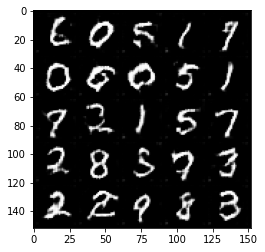

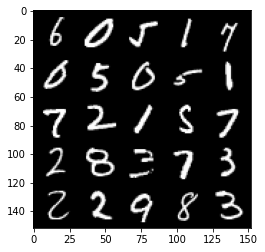

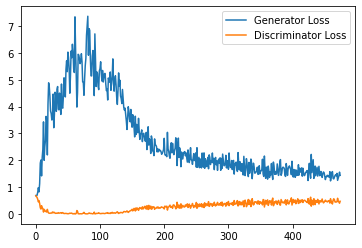

Step 10000: Generator loss: 1.4192090923786163, discriminator loss: 0.4876164734363556


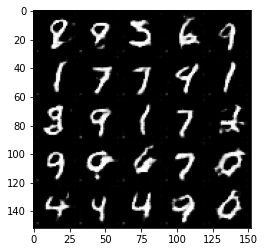

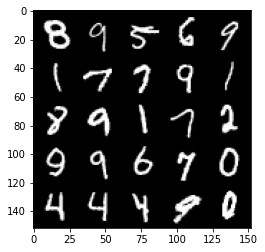

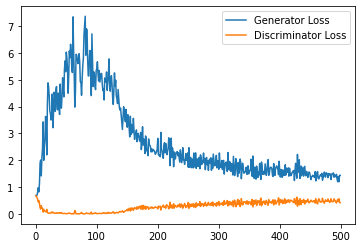

Step 10500: Generator loss: 1.3895216332674027, discriminator loss: 0.49029339945316314


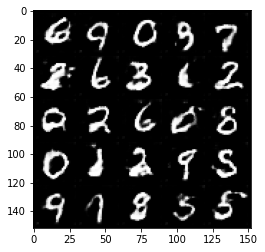

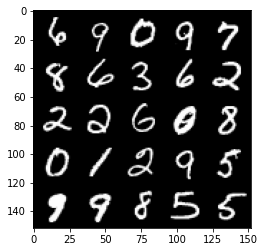

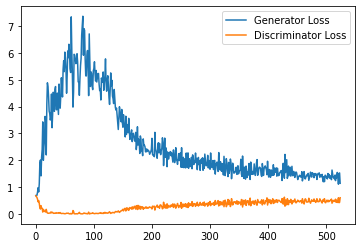

Step 11000: Generator loss: 1.3658608164787291, discriminator loss: 0.4981918874382973


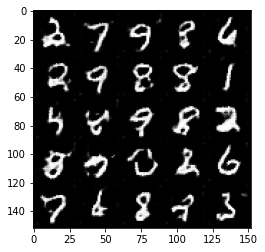

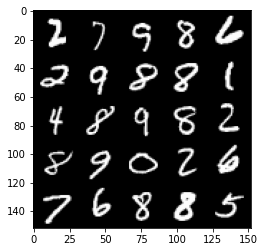

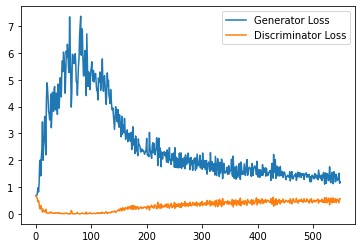

Step 11500: Generator loss: 1.2684909883737565, discriminator loss: 0.5119218081831932


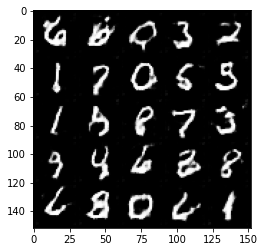

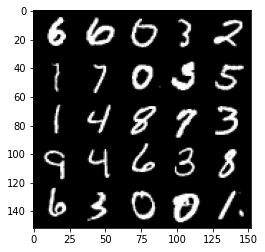

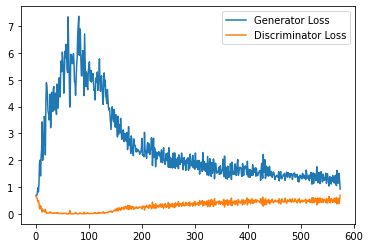

Step 12000: Generator loss: 1.3265501697063447, discriminator loss: 0.5164644435048104


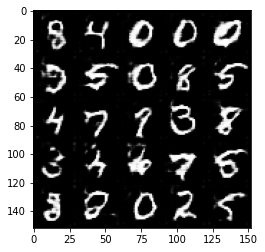

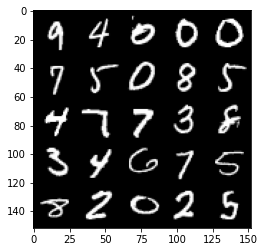

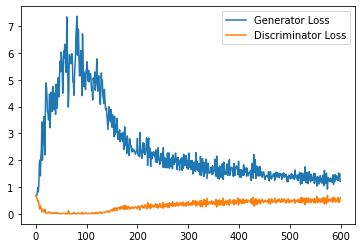

Step 12500: Generator loss: 1.2820039250850677, discriminator loss: 0.5186927400231361


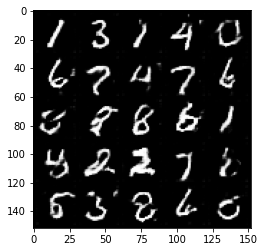

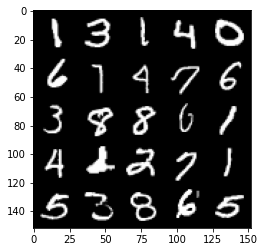

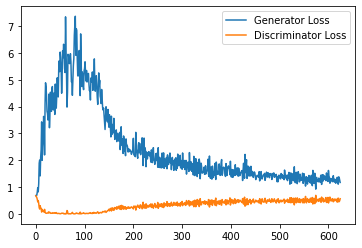

Step 13000: Generator loss: 1.2499663460254669, discriminator loss: 0.5370712683200837


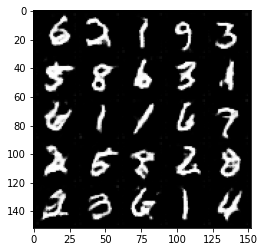

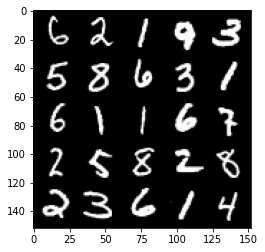

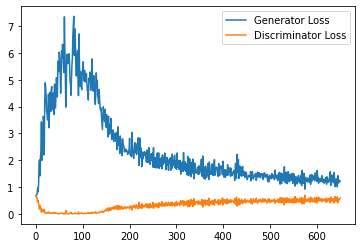

Step 13500: Generator loss: 1.2492818540334703, discriminator loss: 0.529310747385025


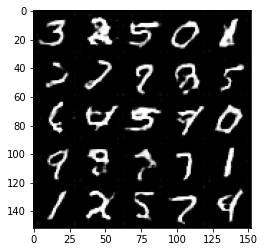

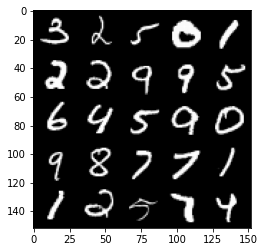

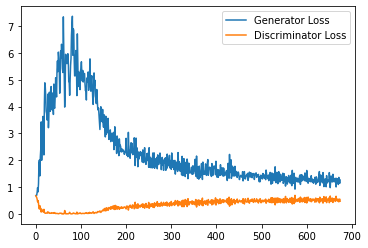

Step 14000: Generator loss: 1.2457896153926848, discriminator loss: 0.5331567085385323


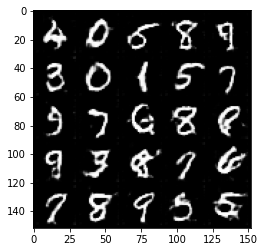

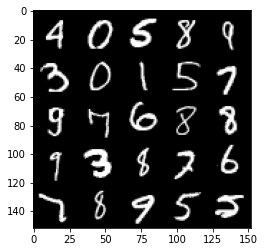

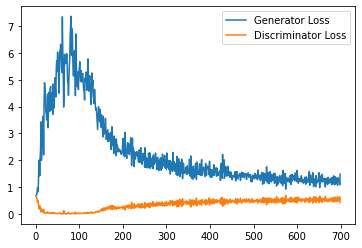

Step 14500: Generator loss: 1.2258948764801025, discriminator loss: 0.5410178502202034


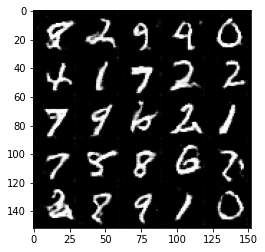

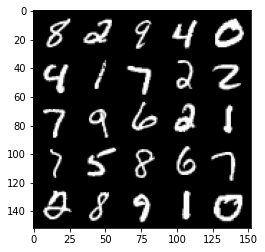

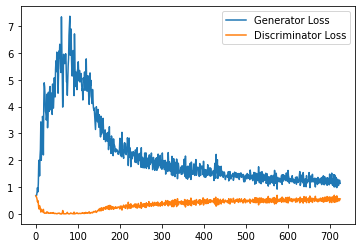

Step 15000: Generator loss: 1.2180167208909989, discriminator loss: 0.5439129473567009


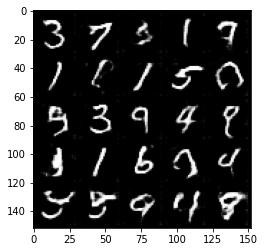

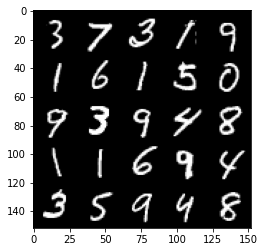

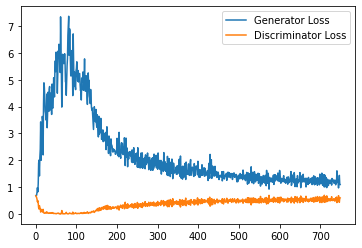

Step 15500: Generator loss: 1.1659646732807158, discriminator loss: 0.5485194261074067


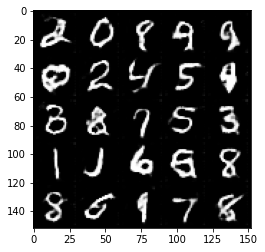

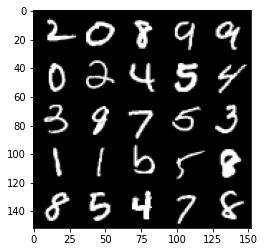

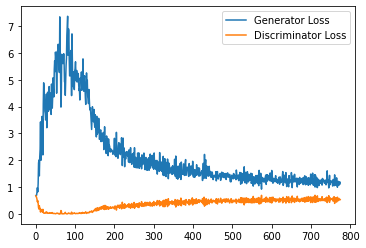

Step 16000: Generator loss: 1.1638474366664886, discriminator loss: 0.5453430368304253


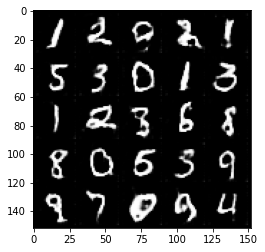

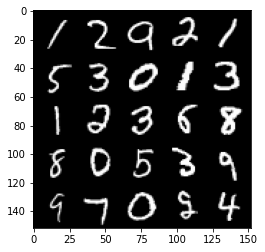

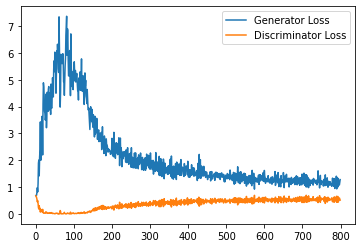

Step 16500: Generator loss: 1.1844563215970993, discriminator loss: 0.5553044066429138


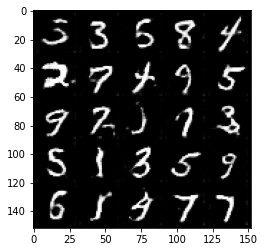

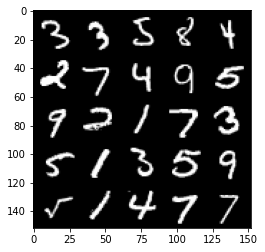

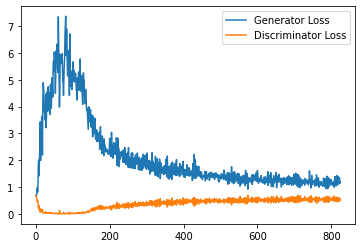

Step 17000: Generator loss: 1.1753765366077422, discriminator loss: 0.5558291882276535


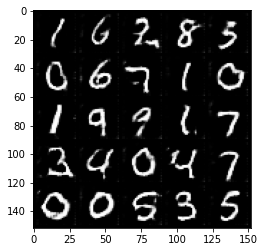

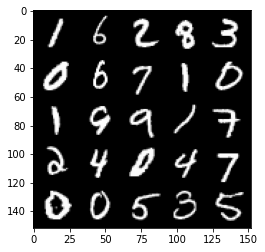

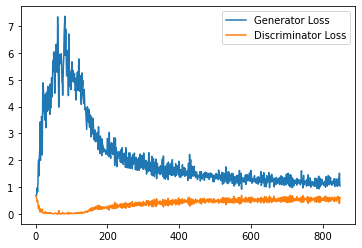

Step 17500: Generator loss: 1.1368115153312683, discriminator loss: 0.5606794169545174


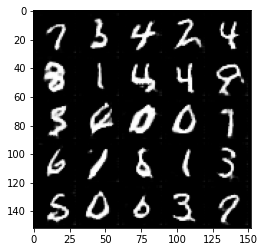

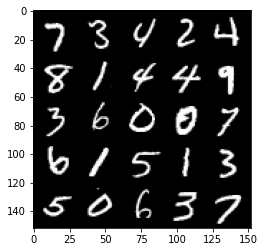

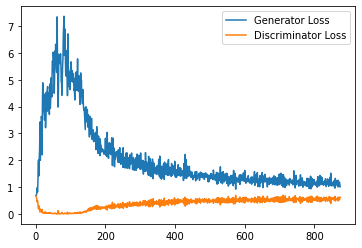

Step 18000: Generator loss: 1.1491938019990922, discriminator loss: 0.5553432953357696


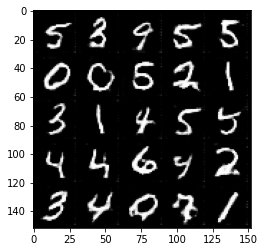

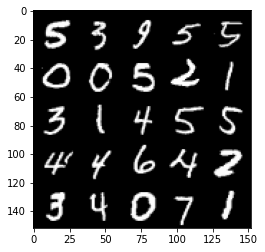

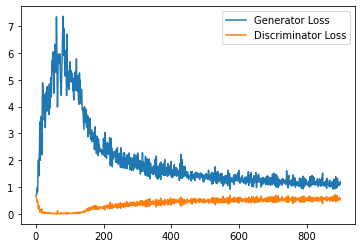

Step 18500: Generator loss: 1.142322406053543, discriminator loss: 0.5596536991000175


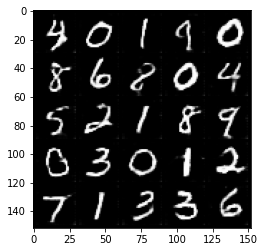

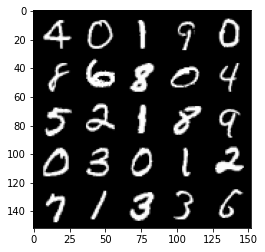

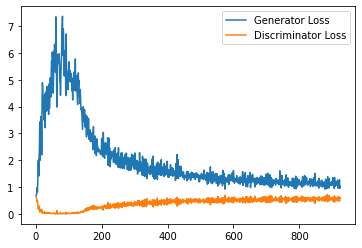

Step 19000: Generator loss: 1.1013172508478164, discriminator loss: 0.5576550459265709


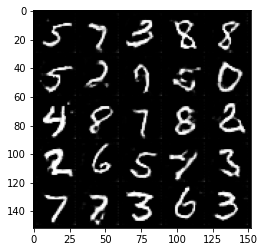

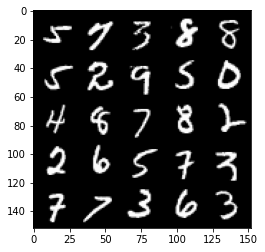

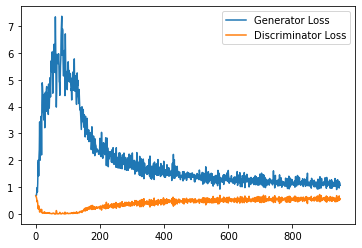

Step 19500: Generator loss: 1.1341533739566803, discriminator loss: 0.5650056990981102


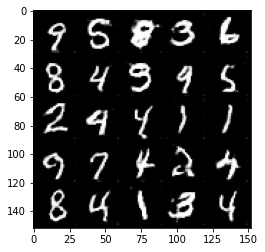

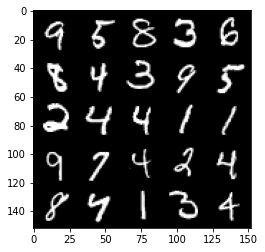

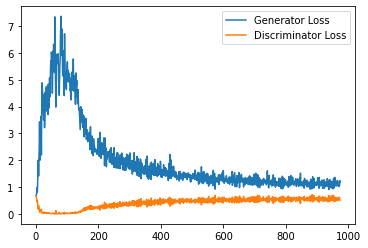

Step 20000: Generator loss: 1.1149094945192337, discriminator loss: 0.5605244643688202


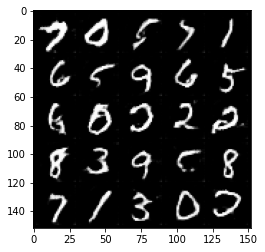

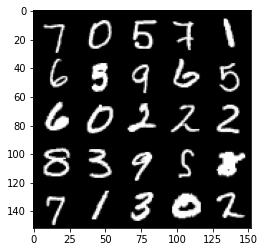

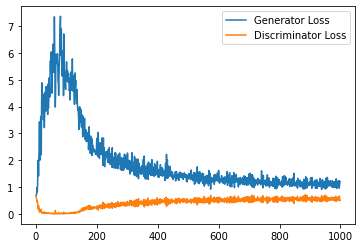

Step 20500: Generator loss: 1.1242053016424178, discriminator loss: 0.5613303973674774


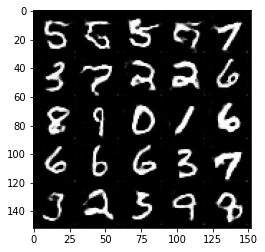

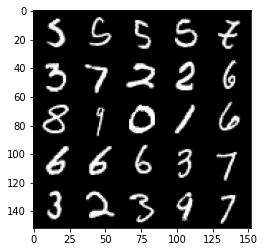

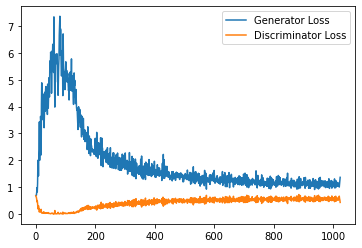

Step 21000: Generator loss: 1.0877737193107604, discriminator loss: 0.5616398679018021


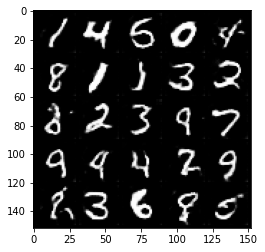

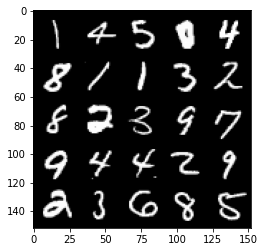

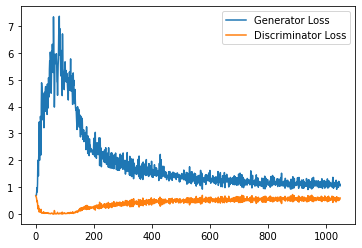

Step 21500: Generator loss: 1.0913294674158096, discriminator loss: 0.5657956901192666


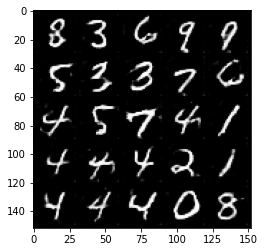

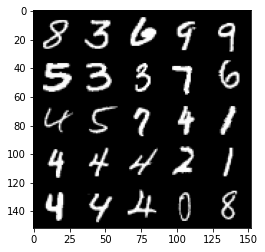

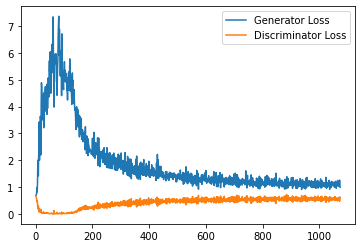

Step 22000: Generator loss: 1.0924490529298783, discriminator loss: 0.5656206018924713


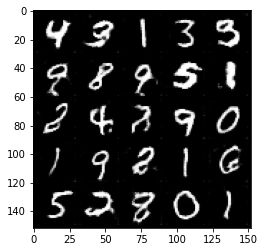

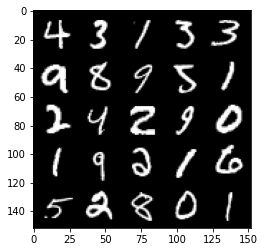

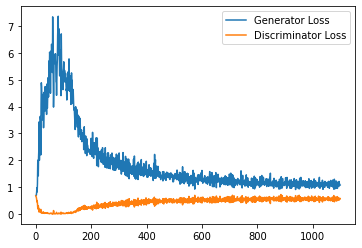

Step 22500: Generator loss: 1.1049513367414474, discriminator loss: 0.5603013342022896


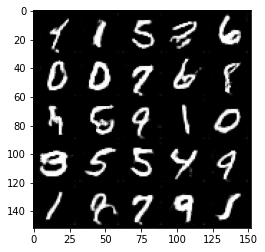

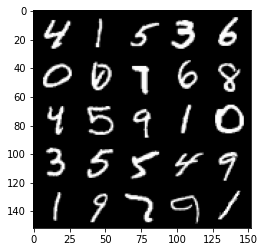

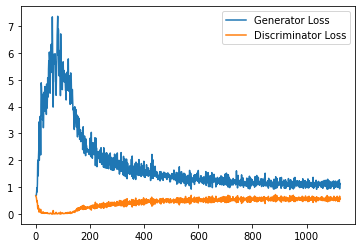

Step 23000: Generator loss: 1.1242821929454803, discriminator loss: 0.5707476163506507


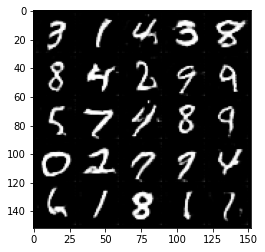

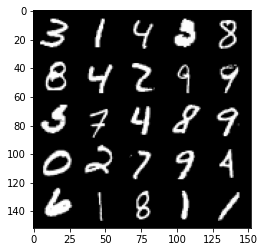

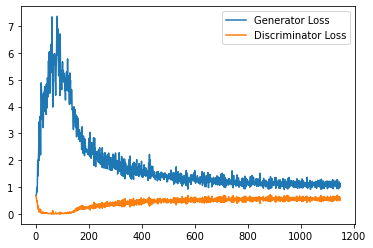

Step 23500: Generator loss: 1.0506607137918473, discriminator loss: 0.5699121564030647


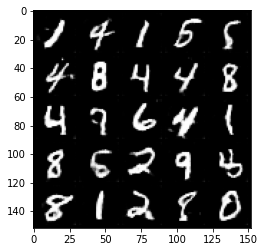

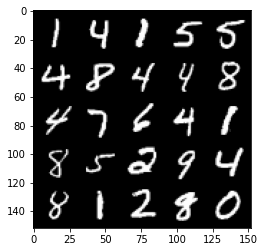

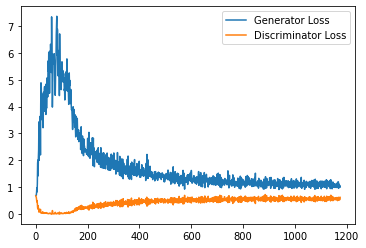

Step 24000: Generator loss: 1.0970802649259568, discriminator loss: 0.5729394209384918


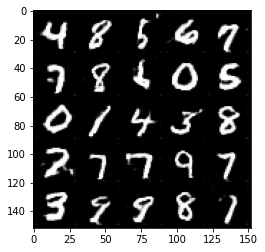

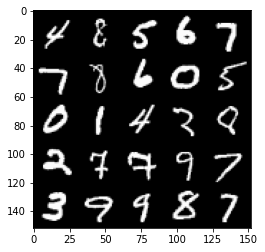

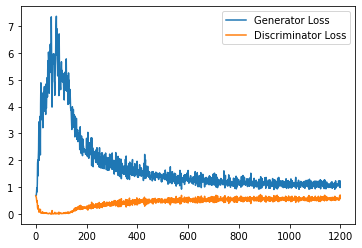

Step 24500: Generator loss: 1.078938302397728, discriminator loss: 0.5648256486654282


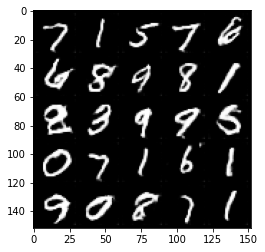

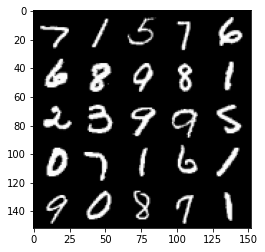

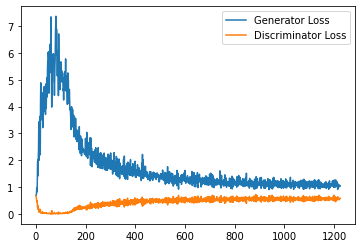

Step 25000: Generator loss: 1.078374322295189, discriminator loss: 0.5697952103018761


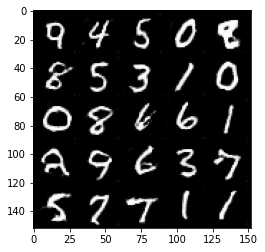

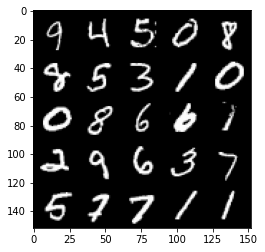

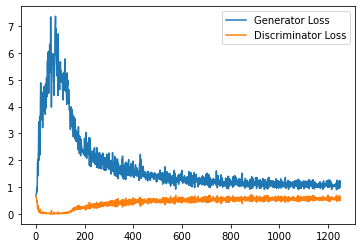

Step 25500: Generator loss: 1.0731754002571106, discriminator loss: 0.5726944146156311


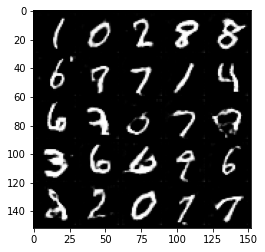

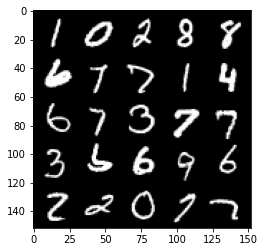

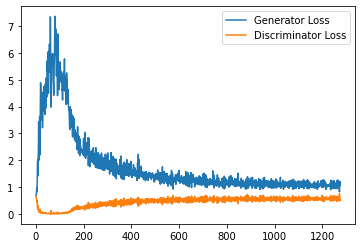

Step 26000: Generator loss: 1.0490728702545167, discriminator loss: 0.5816168679594994


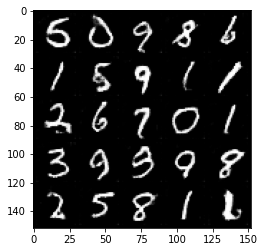

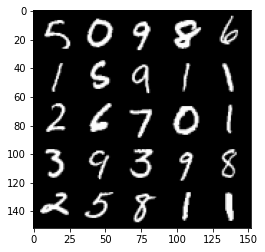

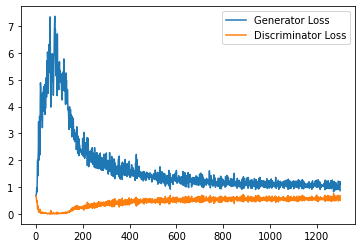

Step 26500: Generator loss: 1.072940147638321, discriminator loss: 0.5702834346294403


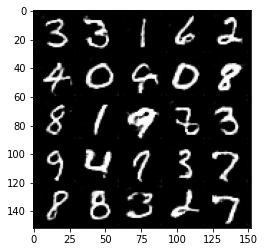

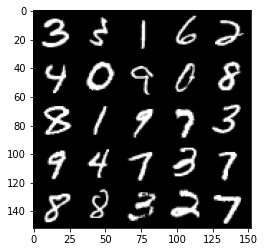

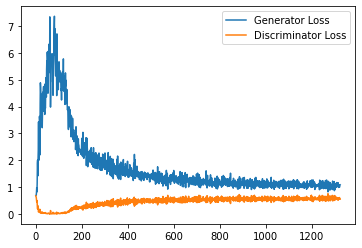

Step 27000: Generator loss: 1.0601951195001602, discriminator loss: 0.571733779668808


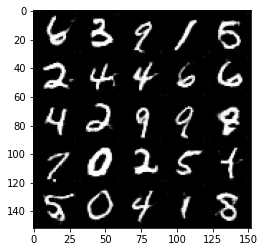

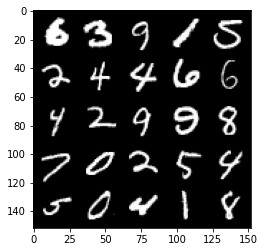

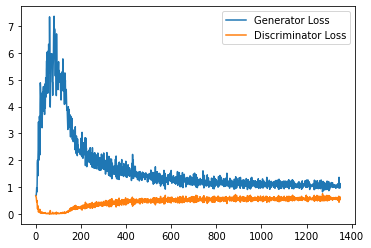

Step 27500: Generator loss: 1.0771175369024277, discriminator loss: 0.5697622917294503


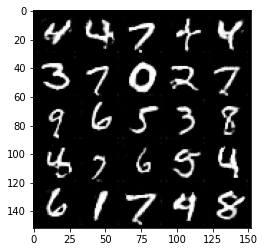

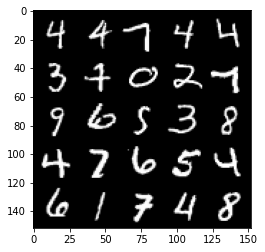

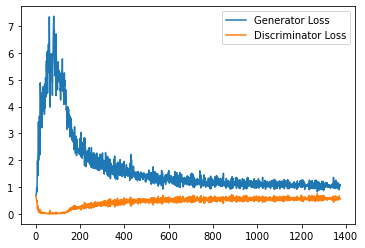

Step 28000: Generator loss: 1.037540680527687, discriminator loss: 0.5816113061904907


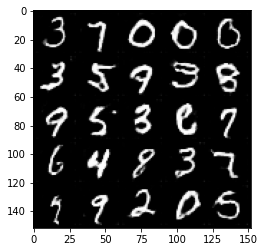

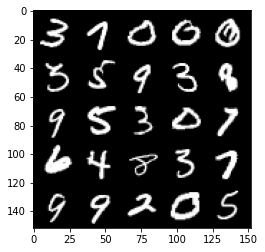

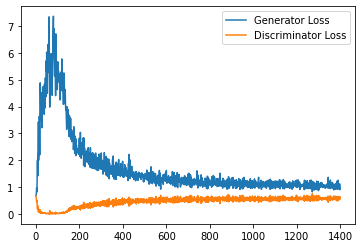

Step 28500: Generator loss: 1.051474483728409, discriminator loss: 0.5808017538785935


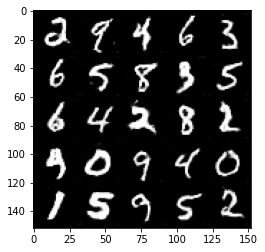

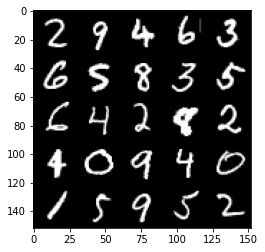

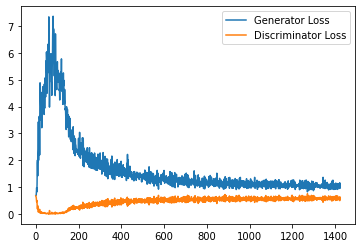

Step 29000: Generator loss: 1.0228594391345978, discriminator loss: 0.5865589621663093


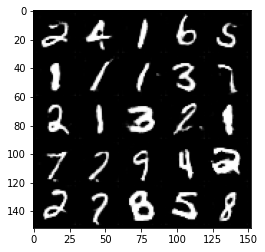

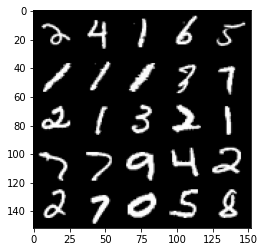

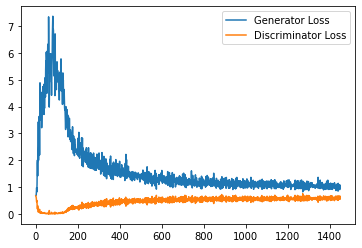

Step 29500: Generator loss: 1.0436504474878312, discriminator loss: 0.5877269811034203


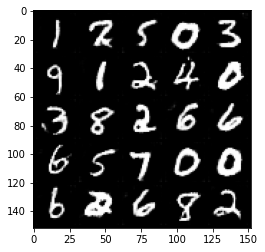

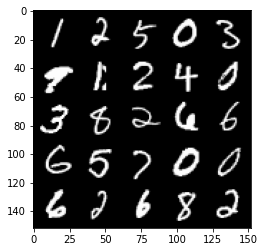

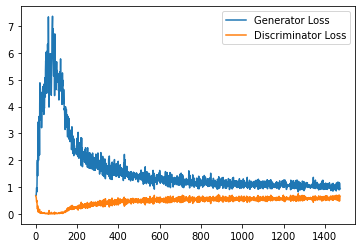

Step 30000: Generator loss: 1.031541443824768, discriminator loss: 0.5863365896344185


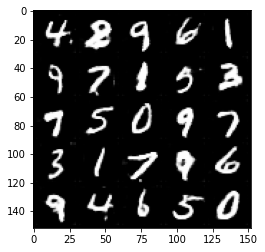

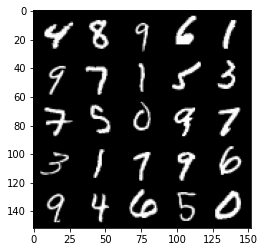

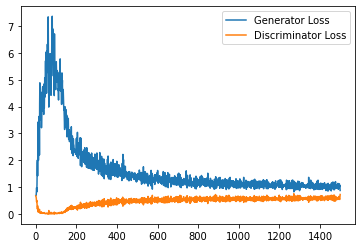

Step 30500: Generator loss: 1.0406560685634614, discriminator loss: 0.5830714808106422


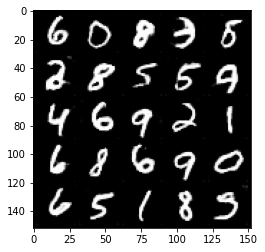

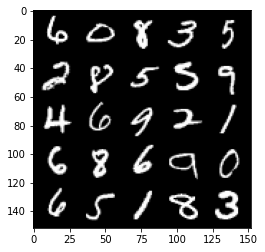

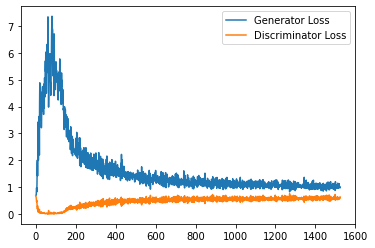

Step 31000: Generator loss: 1.0672229729890823, discriminator loss: 0.5802390577197075


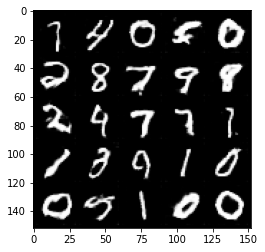

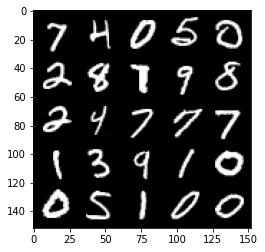

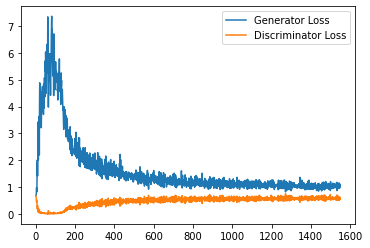

Step 31500: Generator loss: 1.0283163810968399, discriminator loss: 0.5860871121287345


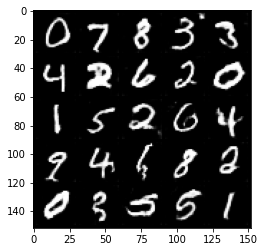

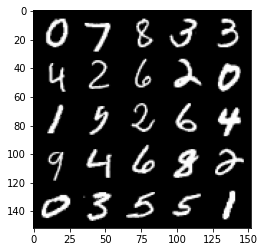

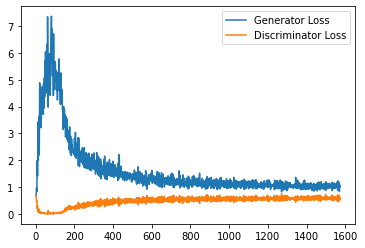

Step 32000: Generator loss: 1.0133789920806884, discriminator loss: 0.589823872089386


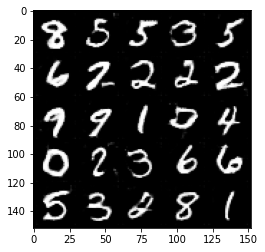

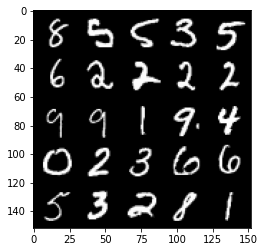

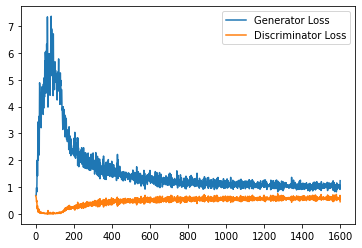

Step 32500: Generator loss: 1.0524913547039032, discriminator loss: 0.5890031395554542


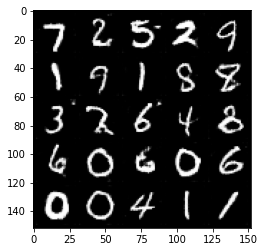

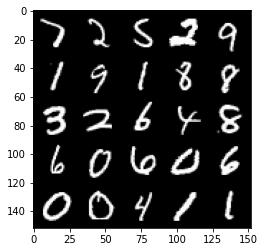

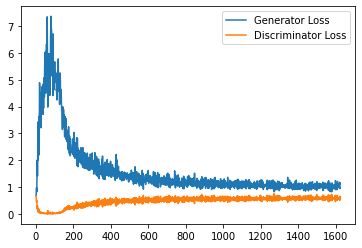

Step 33000: Generator loss: 1.0297040972709657, discriminator loss: 0.5895293509960174


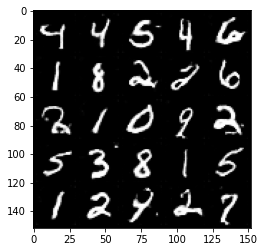

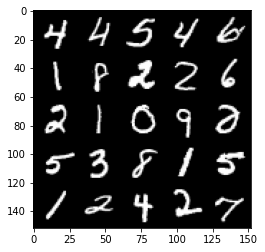

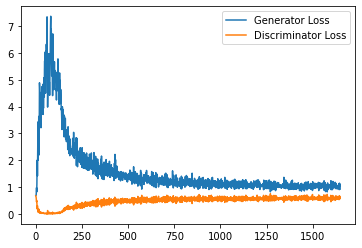

Step 33500: Generator loss: 1.0234458066225052, discriminator loss: 0.5876141006946564


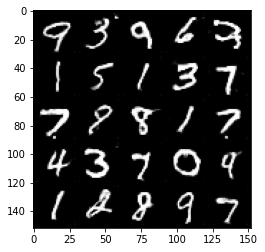

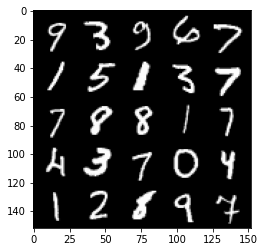

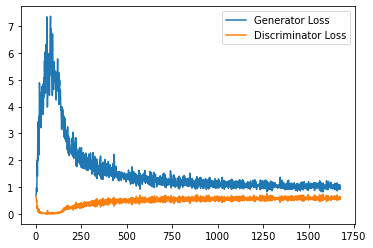

Step 34000: Generator loss: 1.0363351718187332, discriminator loss: 0.5830616983771324


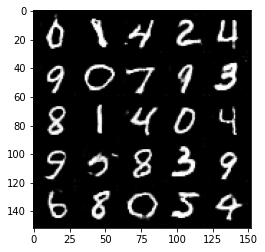

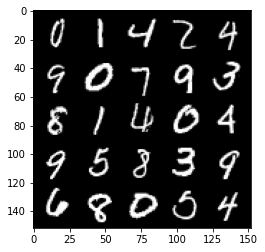

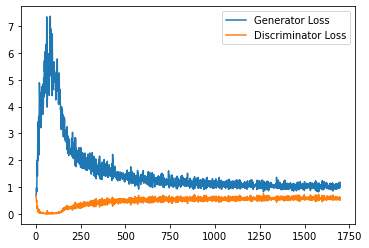

Step 34500: Generator loss: 1.0477238231897354, discriminator loss: 0.5866947984695434


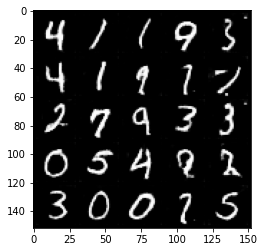

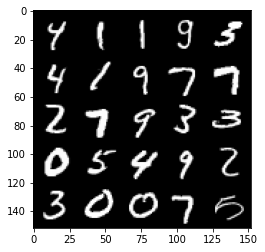

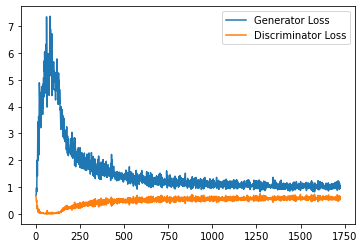

Step 35000: Generator loss: 1.0356377041339875, discriminator loss: 0.5813220982551575


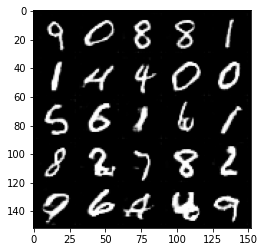

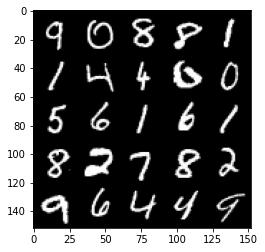

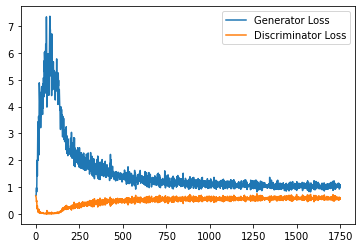

Step 35500: Generator loss: 1.022246352672577, discriminator loss: 0.5868795090317727


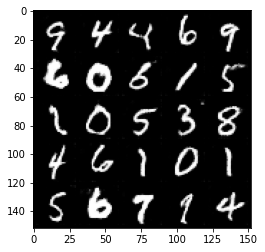

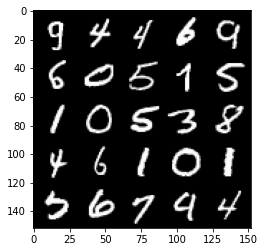

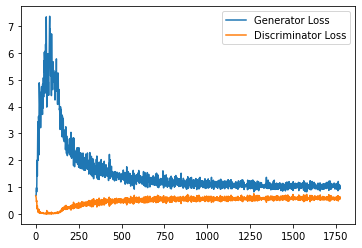

Step 36000: Generator loss: 1.0212169941663742, discriminator loss: 0.5827058729529381


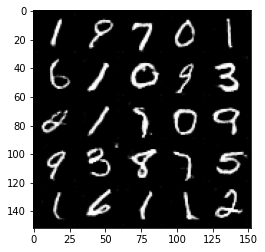

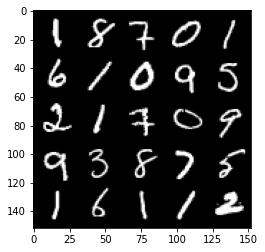

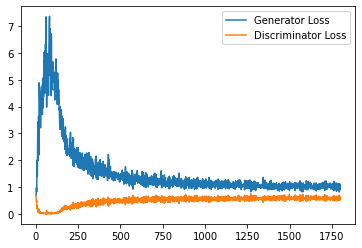

Step 36500: Generator loss: 1.0168981807231903, discriminator loss: 0.5852071704268456


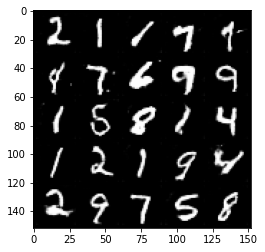

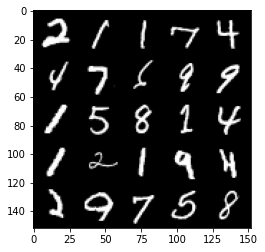

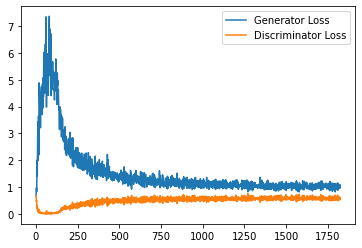

Step 37000: Generator loss: 1.0394052557945253, discriminator loss: 0.5913539459109306


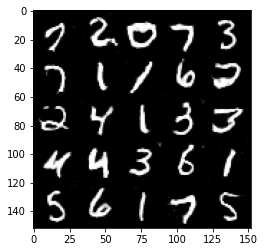

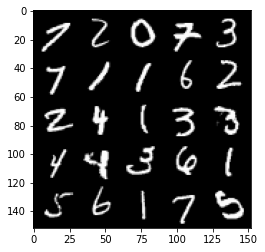

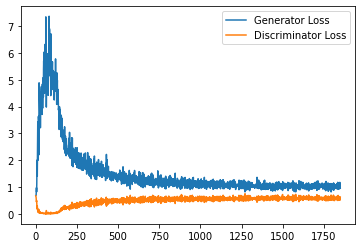

Step 37500: Generator loss: 1.0203030663728714, discriminator loss: 0.5927867239713669


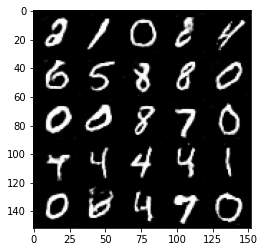

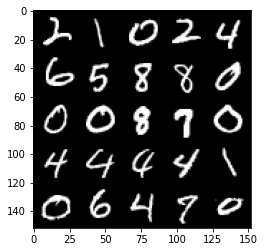

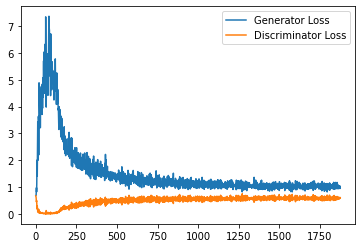

Step 38000: Generator loss: 1.0258003489971161, discriminator loss: 0.5843489628434181


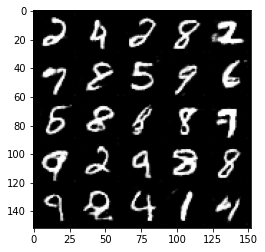

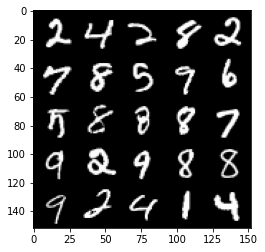

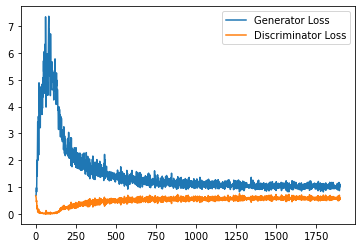

Step 38500: Generator loss: 1.0256908987760545, discriminator loss: 0.5902425471544266


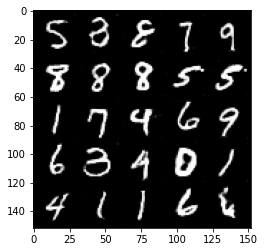

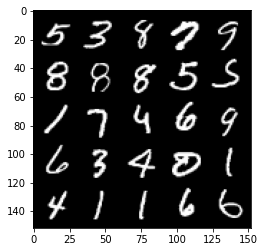

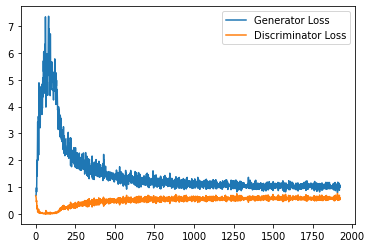

Step 39000: Generator loss: 1.0187633039951325, discriminator loss: 0.5890030030608178


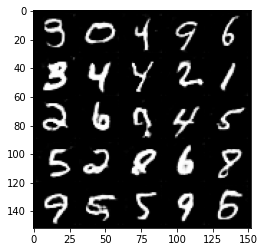

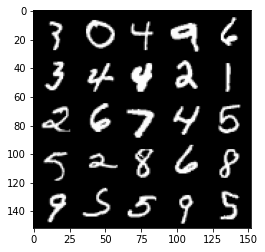

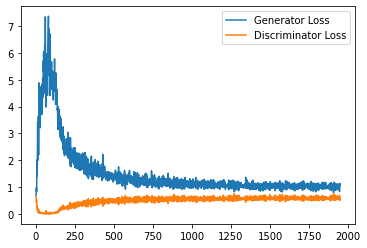

Step 39500: Generator loss: 1.0196930836439133, discriminator loss: 0.5920667871236801


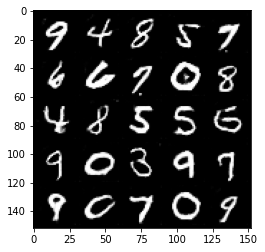

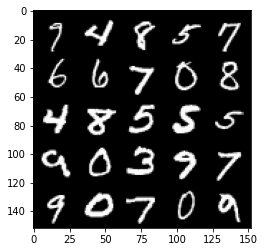

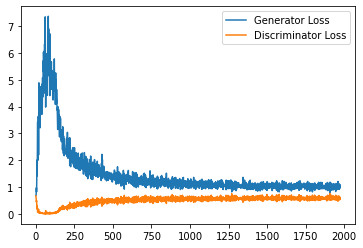

Step 40000: Generator loss: 1.0296029034852983, discriminator loss: 0.5946845871806145


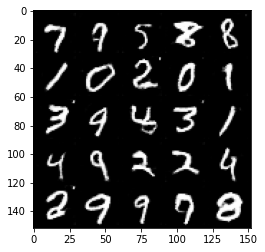

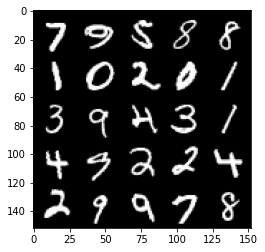

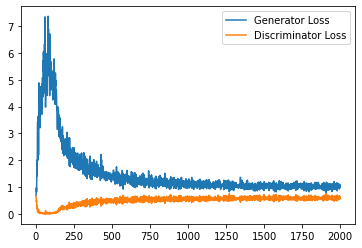

Step 40500: Generator loss: 1.0474684520959854, discriminator loss: 0.583297182738781


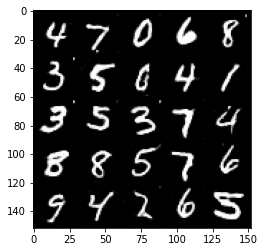

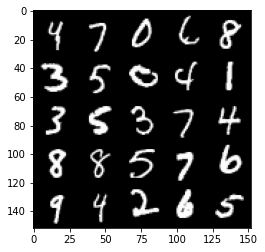

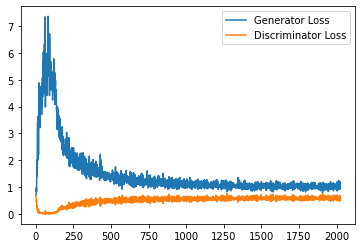

Step 41000: Generator loss: 1.0285018321275712, discriminator loss: 0.5832830955386161


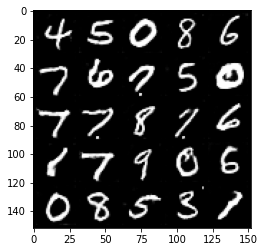

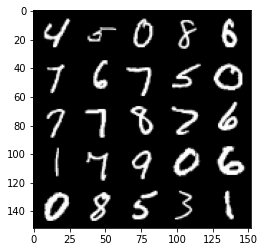

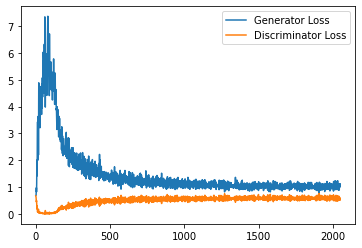

Step 41500: Generator loss: 1.010829429268837, discriminator loss: 0.5855084148049354


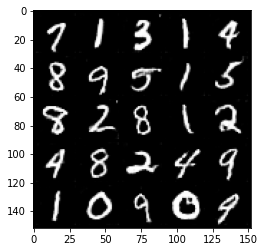

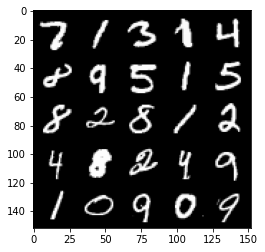

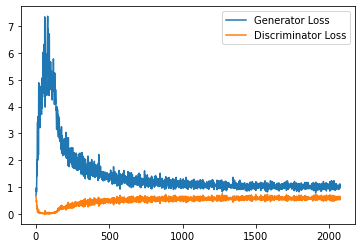

Step 42000: Generator loss: 1.0526323066949845, discriminator loss: 0.5820863634943962


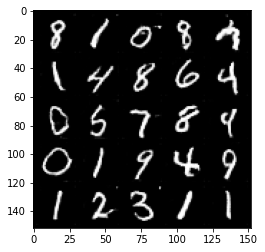

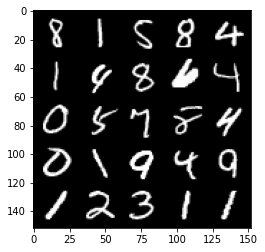

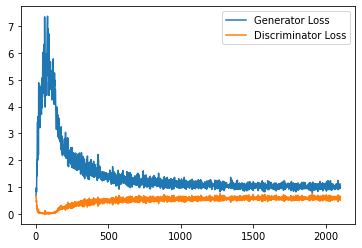

Step 42500: Generator loss: 1.0385646859407425, discriminator loss: 0.5798645495176316


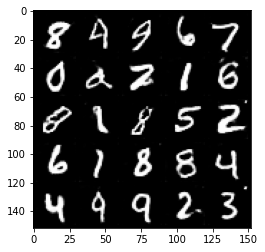

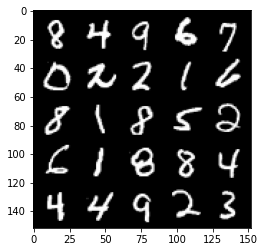

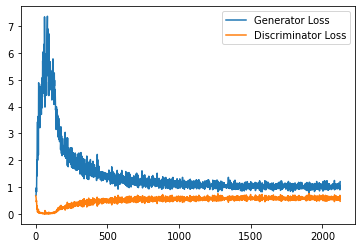

Step 43000: Generator loss: 1.0260537928342819, discriminator loss: 0.580191155731678


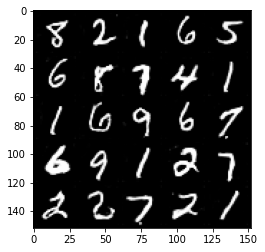

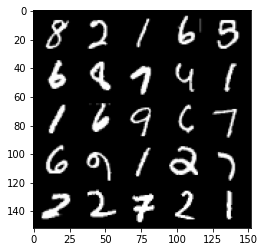

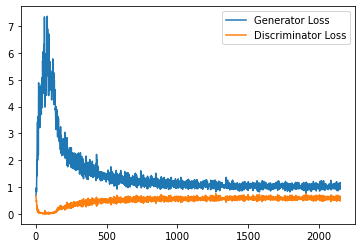

Step 43500: Generator loss: 1.0379337624311447, discriminator loss: 0.5814025356769562


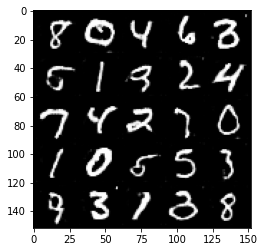

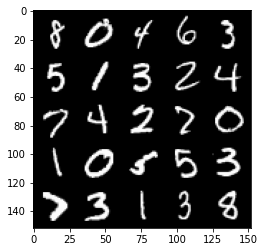

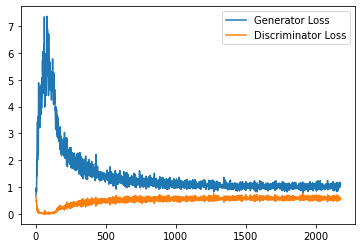

Step 44000: Generator loss: 1.065127941608429, discriminator loss: 0.5843732953071594


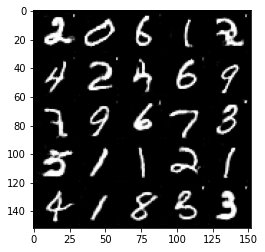

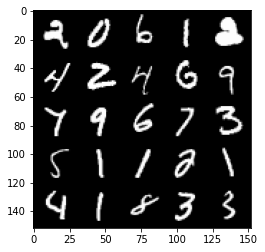

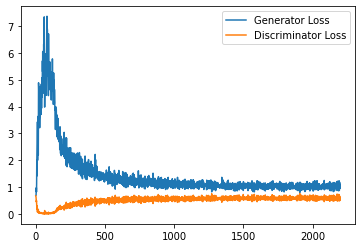

Step 44500: Generator loss: 1.0223562638759613, discriminator loss: 0.585880218565464


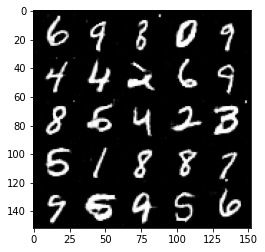

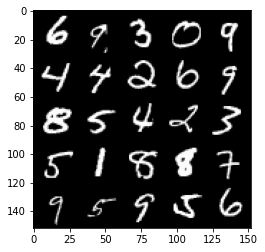

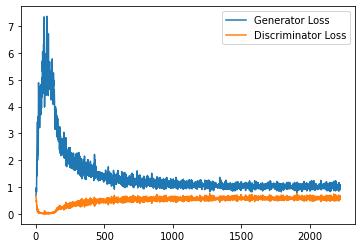

Step 45000: Generator loss: 1.0530561908483504, discriminator loss: 0.5786756645441056


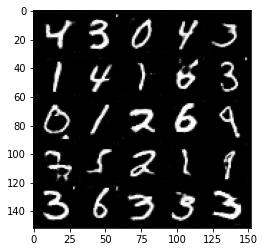

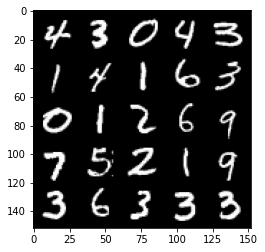

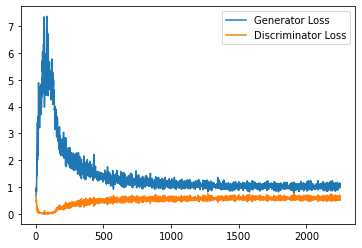

Step 45500: Generator loss: 1.0389036380052568, discriminator loss: 0.5789019355773926


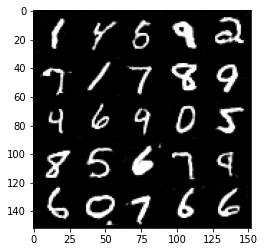

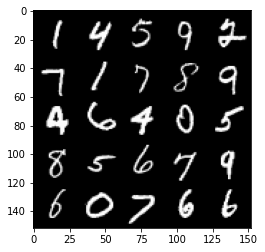

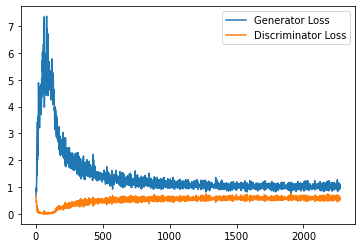

Step 46000: Generator loss: 1.0336365796327591, discriminator loss: 0.5801925652623177


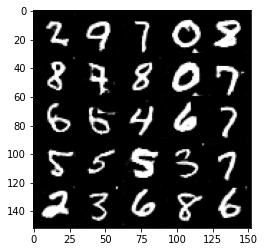

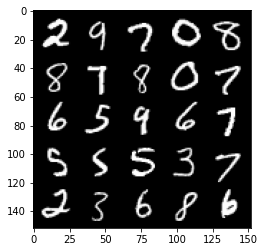

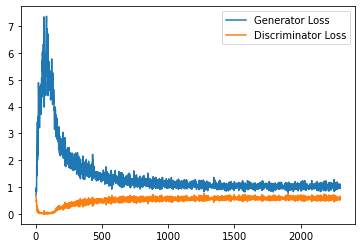

Step 46500: Generator loss: 1.0464784613847733, discriminator loss: 0.5707615699768066


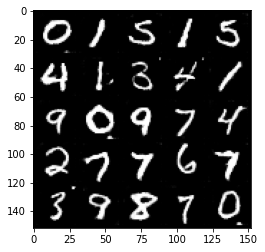

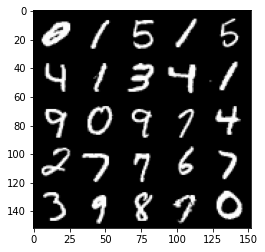

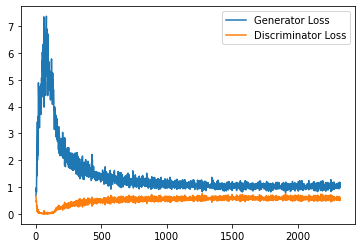

Step 47000: Generator loss: 1.0645897735357284, discriminator loss: 0.5708689262270927


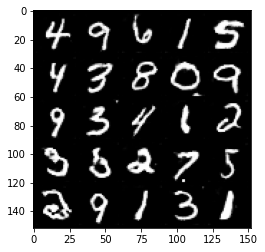

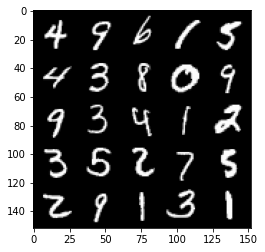

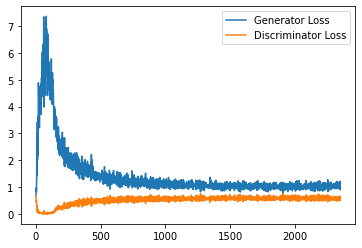

Step 47500: Generator loss: 1.0691771372556687, discriminator loss: 0.5739187347888947


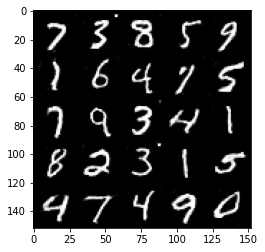

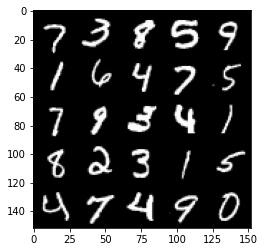

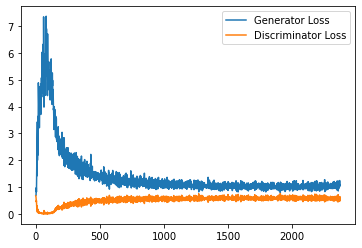

Step 48000: Generator loss: 1.052168568611145, discriminator loss: 0.566666919708252


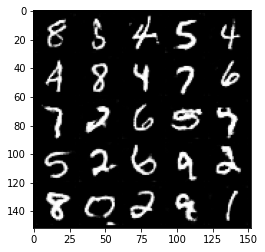

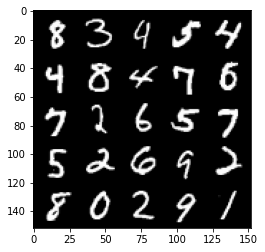

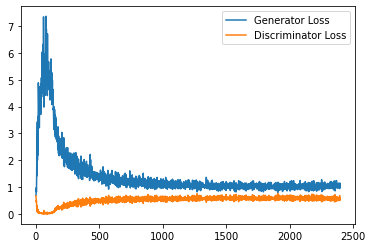

Step 48500: Generator loss: 1.06339291036129, discriminator loss: 0.5740245455503463


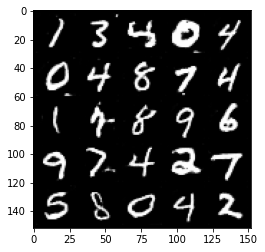

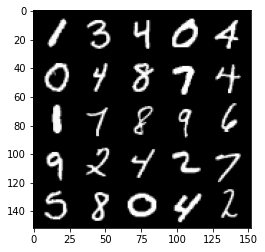

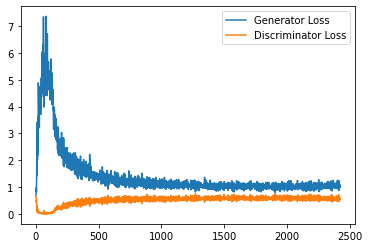

Step 49000: Generator loss: 1.085461808681488, discriminator loss: 0.5692117355465889


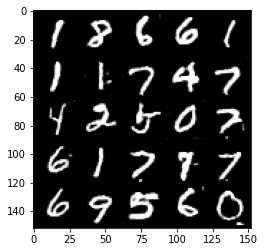

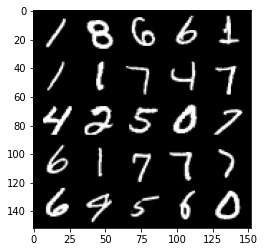

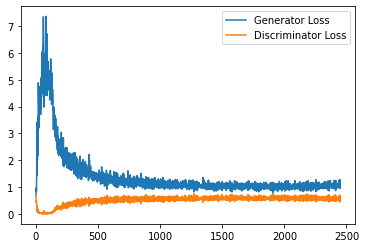

Step 49500: Generator loss: 1.0664566041231156, discriminator loss: 0.5632211225032806


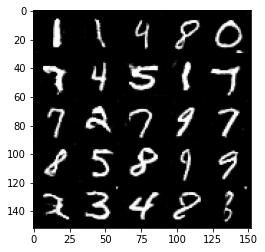

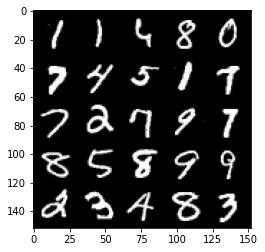

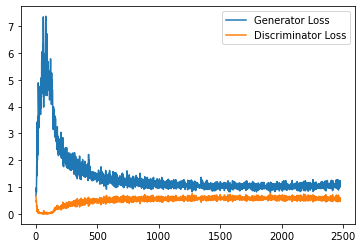

Step 50000: Generator loss: 1.0757117252349853, discriminator loss: 0.5602848255634307


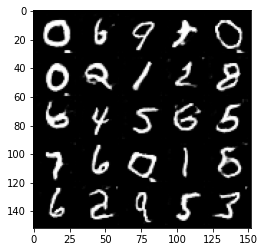

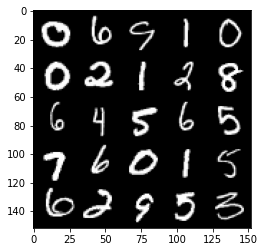

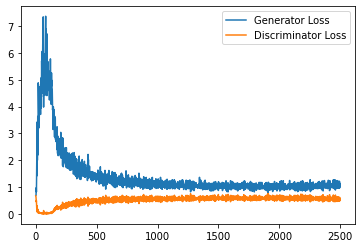

Step 50500: Generator loss: 1.056720888733864, discriminator loss: 0.5704923343658447


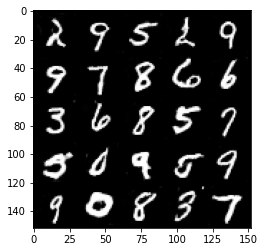

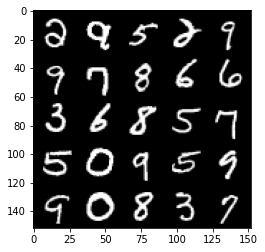

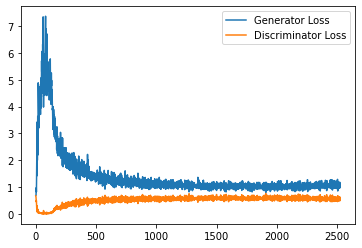

Step 51000: Generator loss: 1.0801306062936782, discriminator loss: 0.5602447112202644


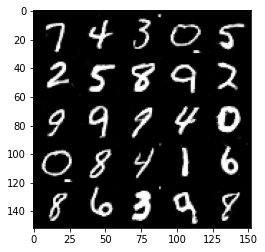

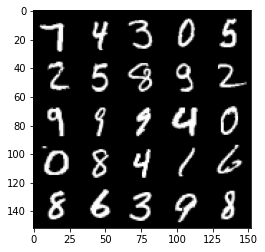

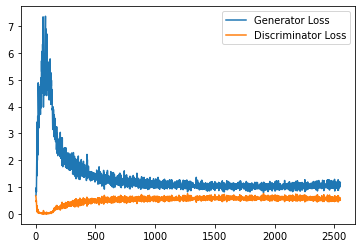

Step 51500: Generator loss: 1.0887440954446792, discriminator loss: 0.5627669211030006


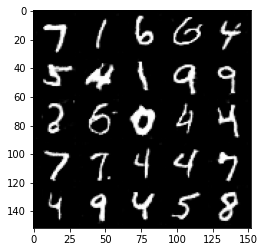

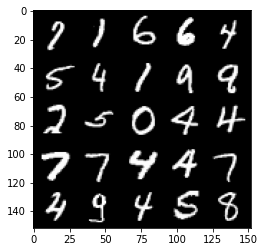

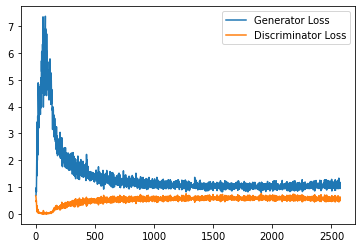

Step 52000: Generator loss: 1.082654916524887, discriminator loss: 0.5558067129254342


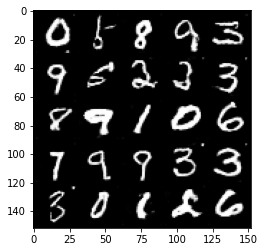

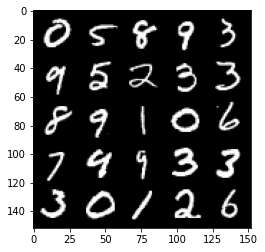

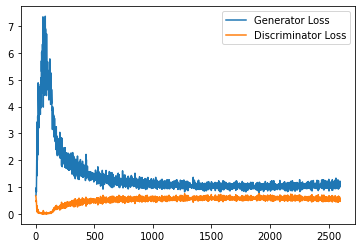

Step 52500: Generator loss: 1.0654597330093383, discriminator loss: 0.5643801054358483


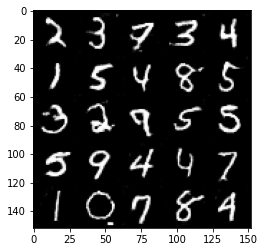

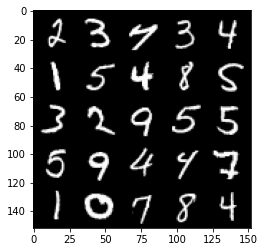

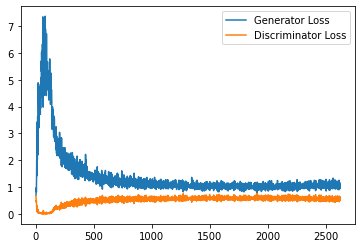

Step 53000: Generator loss: 1.111170050740242, discriminator loss: 0.5540695023536683


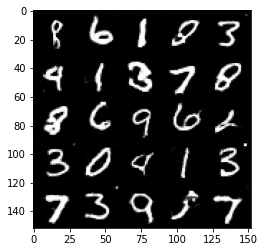

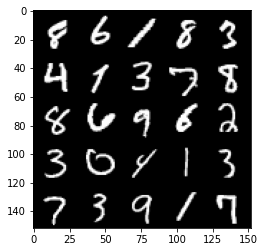

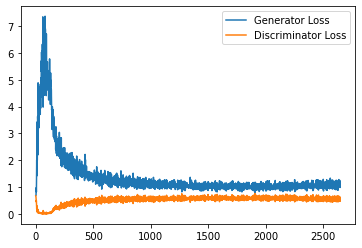

Step 53500: Generator loss: 1.0889958941936493, discriminator loss: 0.5560033730864525


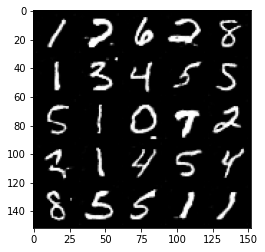

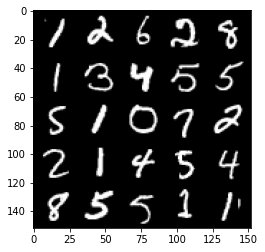

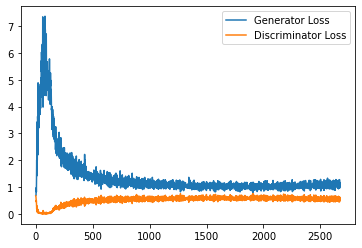

Step 54000: Generator loss: 1.1223530983924865, discriminator loss: 0.5461174256801605


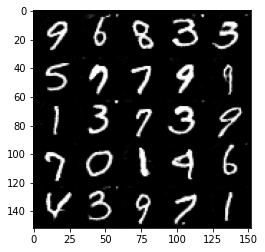

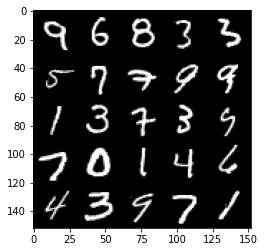

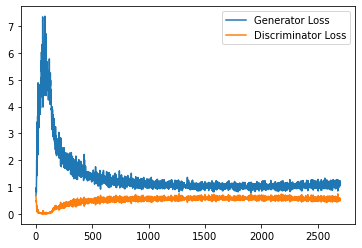

Step 54500: Generator loss: 1.0905346276760102, discriminator loss: 0.5566368427872658


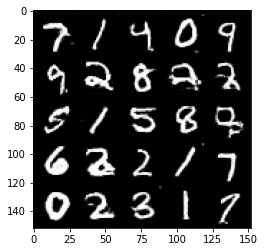

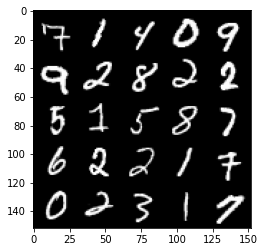

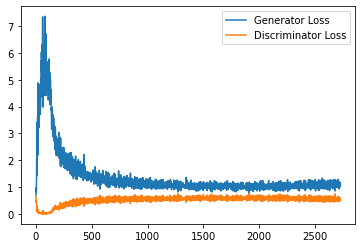

Step 55000: Generator loss: 1.11367216360569, discriminator loss: 0.5437782856225968


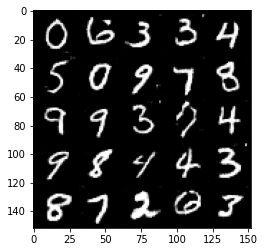

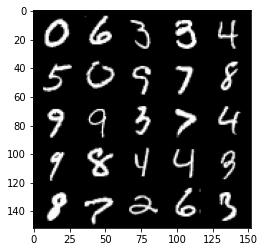

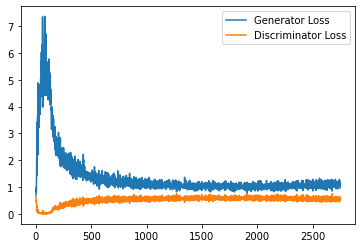

Step 55500: Generator loss: 1.1164028891324997, discriminator loss: 0.5495265649557114


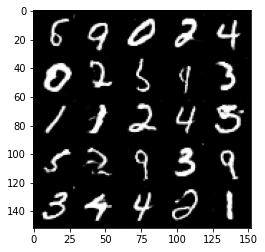

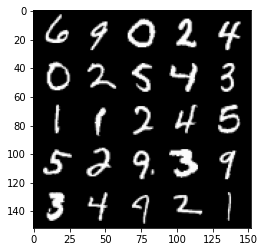

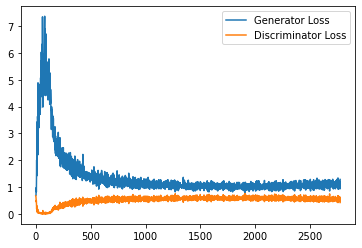

Step 56000: Generator loss: 1.1214497184753418, discriminator loss: 0.5517608972191811


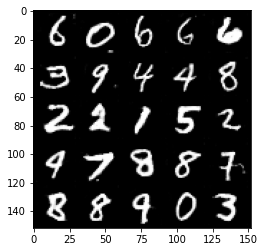

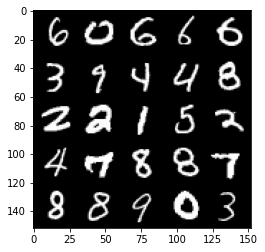

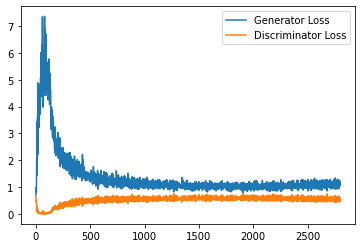

Step 56500: Generator loss: 1.1284836745262146, discriminator loss: 0.5484782680273056


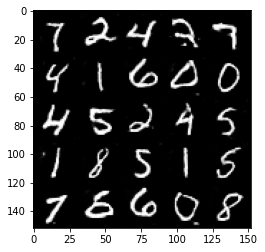

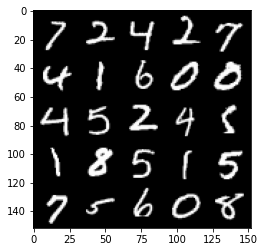

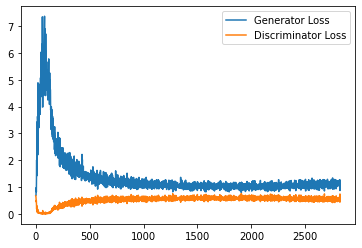

Step 57000: Generator loss: 1.1245521332025528, discriminator loss: 0.5458594179749489


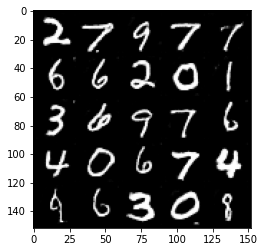

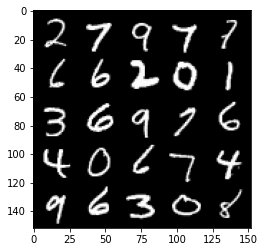

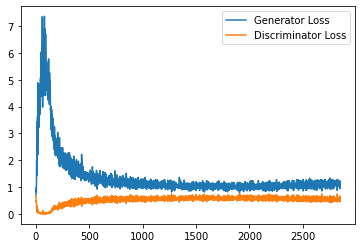

Step 57500: Generator loss: 1.0983066288232803, discriminator loss: 0.5509680965542794


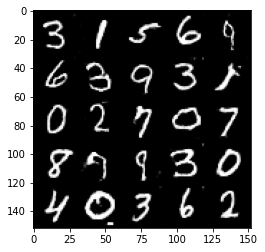

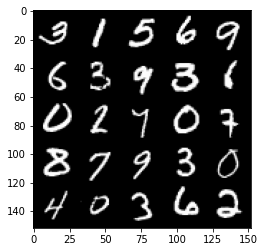

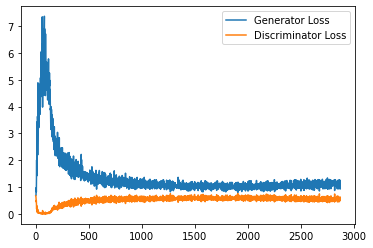

Step 58000: Generator loss: 1.1057406620979309, discriminator loss: 0.5408297248482704


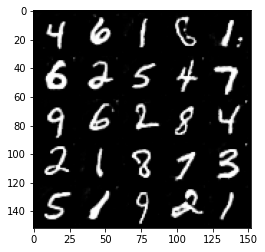

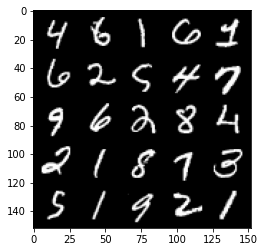

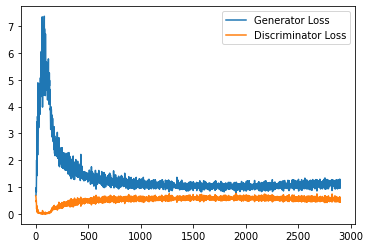

Step 58500: Generator loss: 1.125747713804245, discriminator loss: 0.5438285773992538


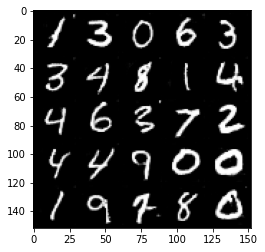

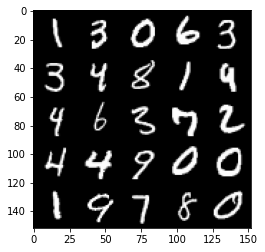

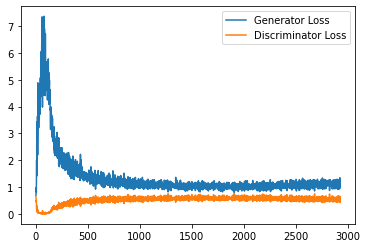

Step 59000: Generator loss: 1.1112740304470061, discriminator loss: 0.5548858754038811


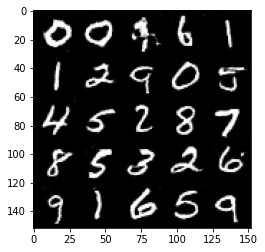

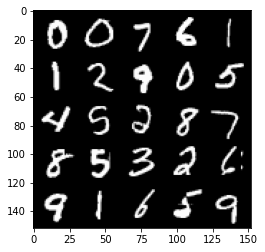

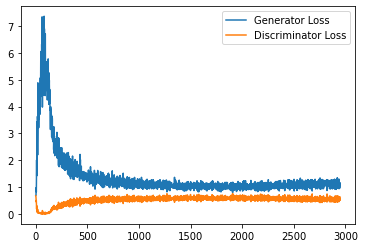

Step 59500: Generator loss: 1.1390234017372132, discriminator loss: 0.5381085275411606


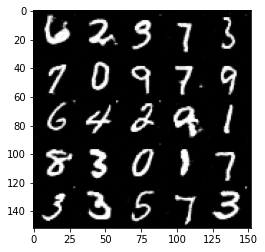

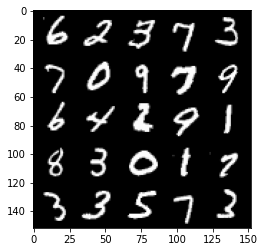

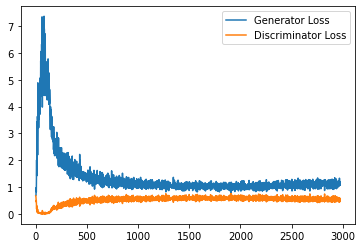

Step 60000: Generator loss: 1.1445955730676651, discriminator loss: 0.5429346641898155


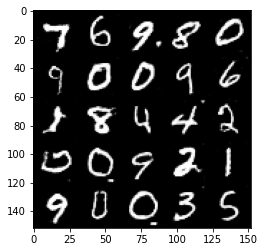

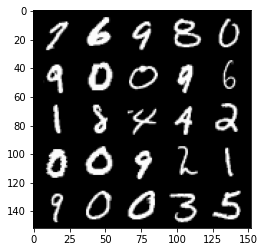

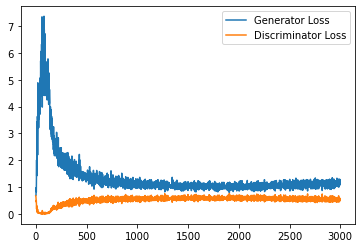

Step 60500: Generator loss: 1.1397898914813995, discriminator loss: 0.5403954563736916


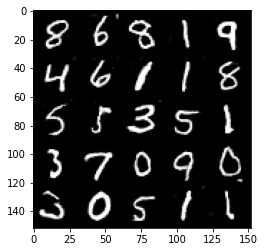

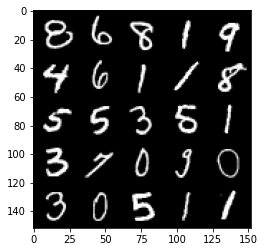

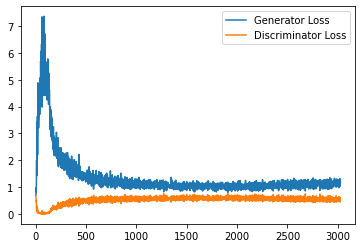

Step 61000: Generator loss: 1.123344424009323, discriminator loss: 0.5474821095466613


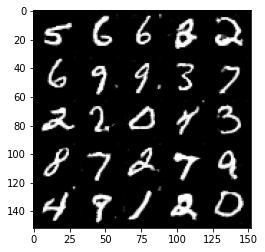

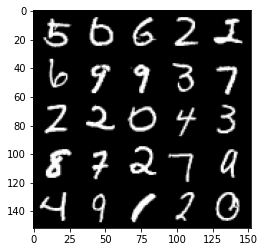

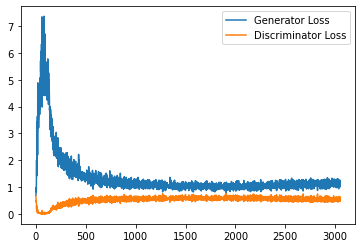

Step 61500: Generator loss: 1.1621963909864426, discriminator loss: 0.5440835111737251


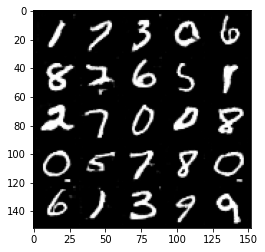

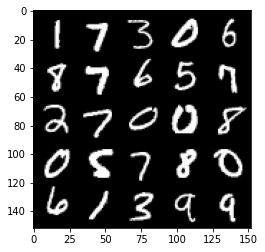

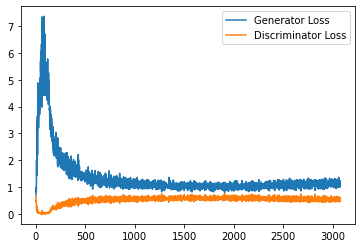

Step 62000: Generator loss: 1.1393358601331711, discriminator loss: 0.542737283051014


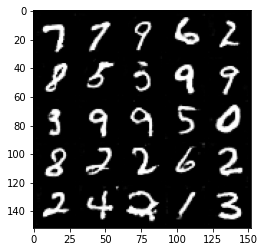

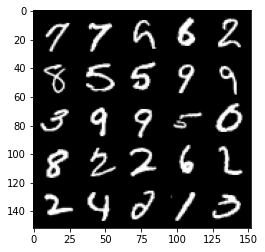

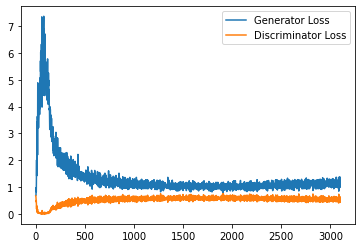

Step 62500: Generator loss: 1.152652688384056, discriminator loss: 0.5411429918408394


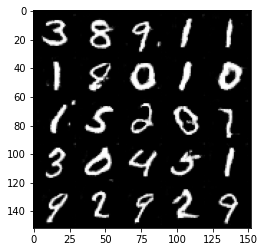

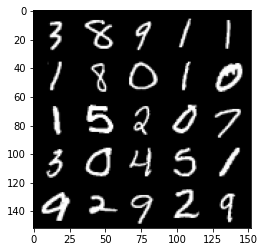

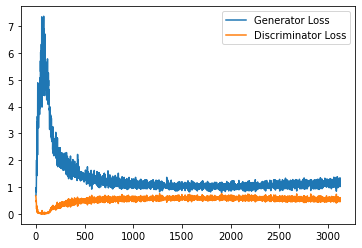

Step 63000: Generator loss: 1.1439831619262695, discriminator loss: 0.5439778822064399


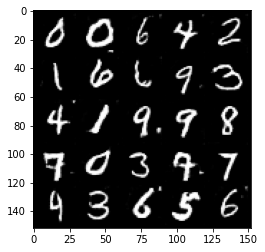

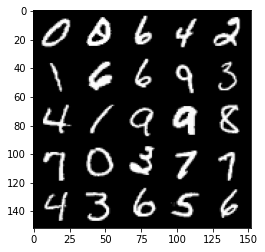

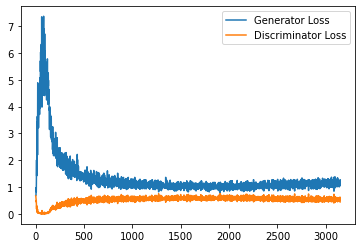

Step 63500: Generator loss: 1.1479594839811325, discriminator loss: 0.5363831358551979


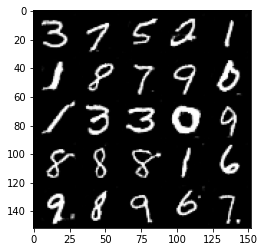

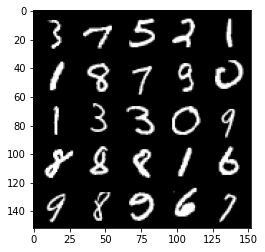

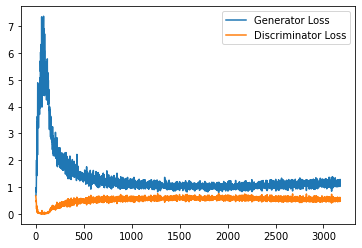

Step 64000: Generator loss: 1.1543704825639725, discriminator loss: 0.5372692403793335


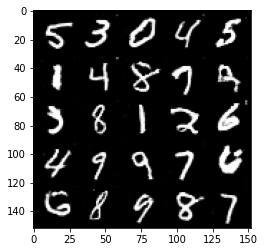

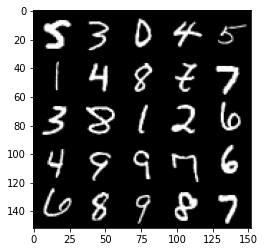

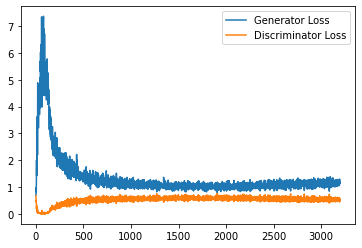

Step 64500: Generator loss: 1.137992759823799, discriminator loss: 0.5479305608868599


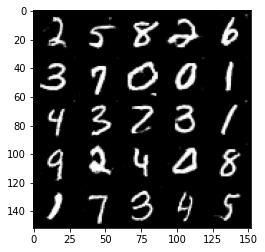

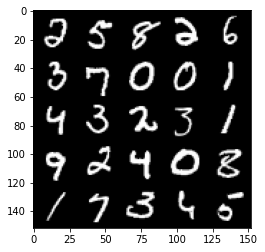

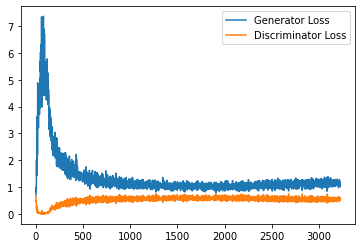

Step 65000: Generator loss: 1.139678094625473, discriminator loss: 0.5407423485517502


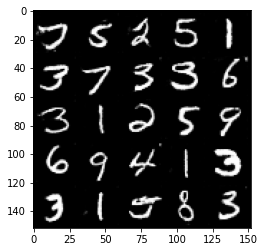

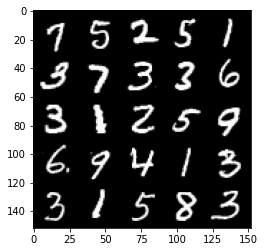

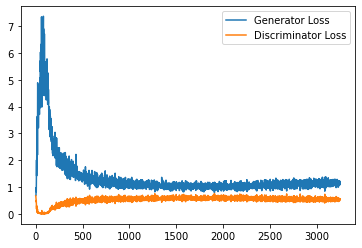

Step 65500: Generator loss: 1.1444845031499862, discriminator loss: 0.5436880646944046


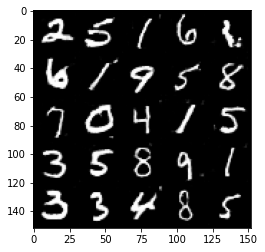

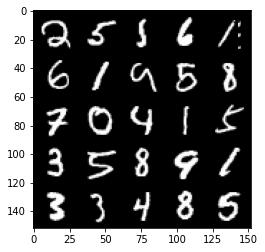

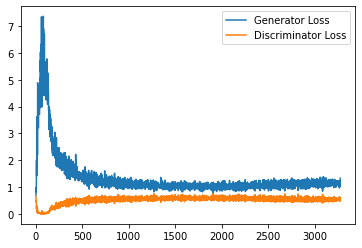

Step 66000: Generator loss: 1.144249249100685, discriminator loss: 0.5440375149846077


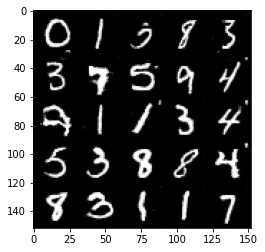

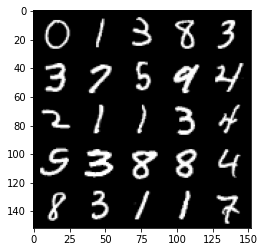

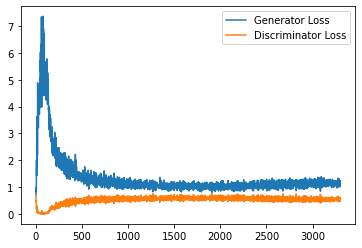

Step 66500: Generator loss: 1.1457110188007356, discriminator loss: 0.5431887230873108


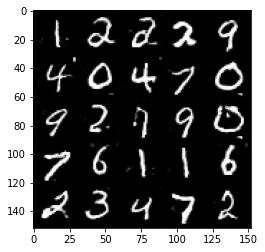

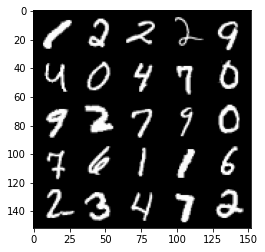

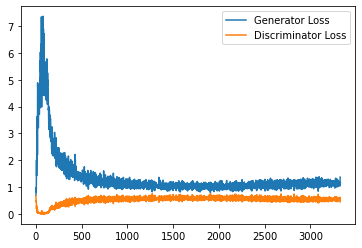

Step 67000: Generator loss: 1.1345214825868606, discriminator loss: 0.548314158320427


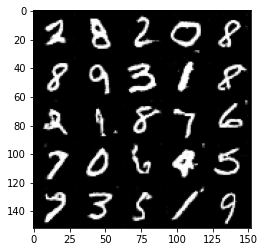

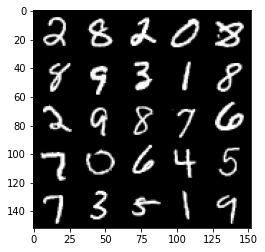

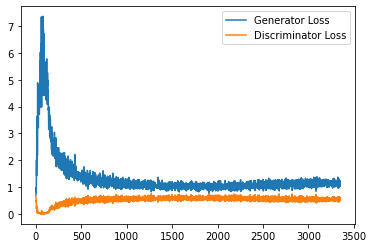

Step 67500: Generator loss: 1.1477044594287873, discriminator loss: 0.5425114881396293


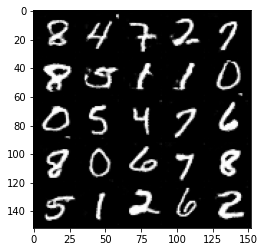

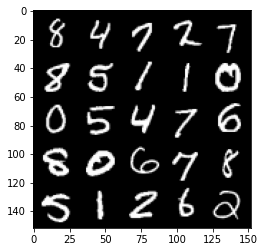

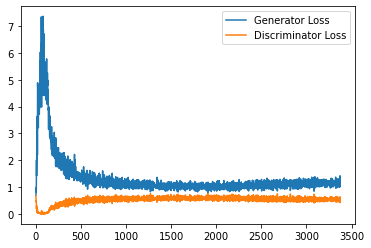

Step 68000: Generator loss: 1.1494364483952522, discriminator loss: 0.5444604851007462


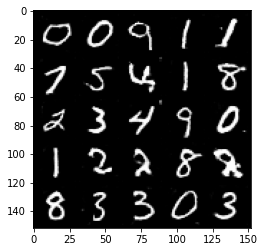

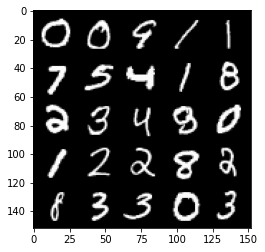

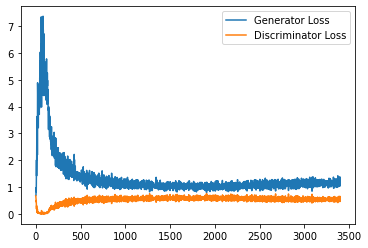

Step 68500: Generator loss: 1.1351277638673782, discriminator loss: 0.5511721143722534


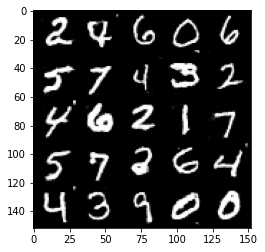

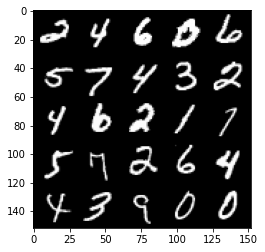

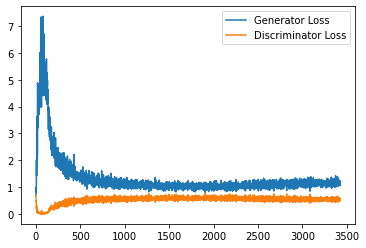

Step 69000: Generator loss: 1.169687332034111, discriminator loss: 0.5401722660660744


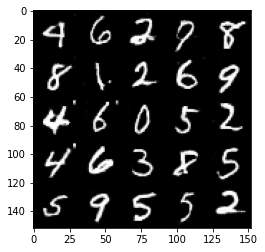

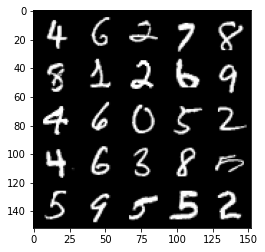

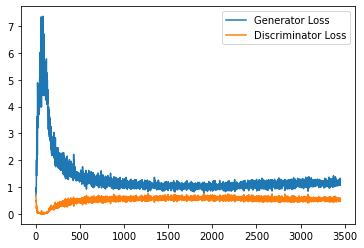

Step 69500: Generator loss: 1.1683049705028534, discriminator loss: 0.5427071715593338


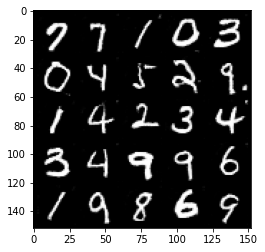

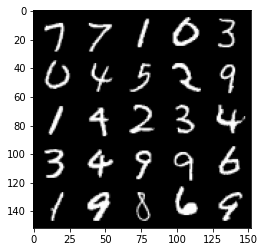

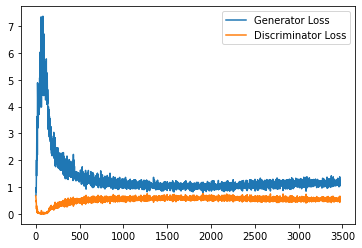

Step 70000: Generator loss: 1.1406702576875687, discriminator loss: 0.54903256046772


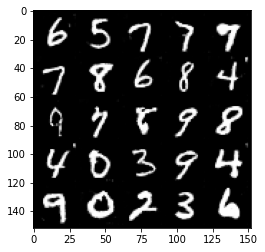

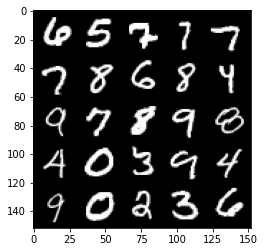

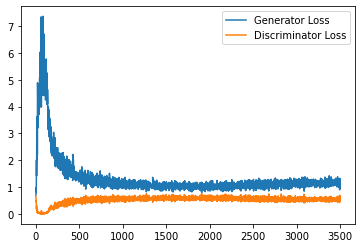

Step 70500: Generator loss: 1.145214382171631, discriminator loss: 0.5418336569070816


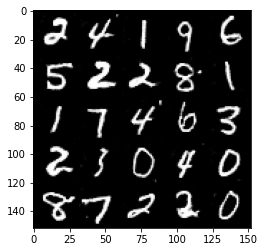

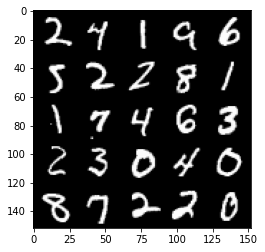

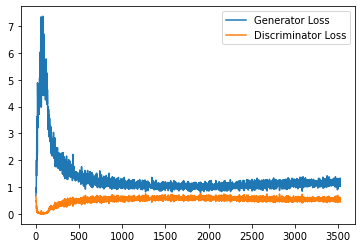

Step 71000: Generator loss: 1.1643371539115905, discriminator loss: 0.538501861512661


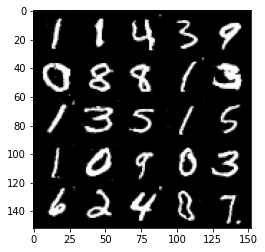

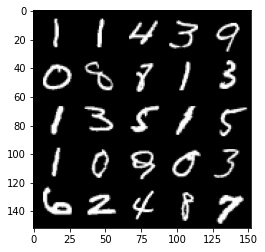

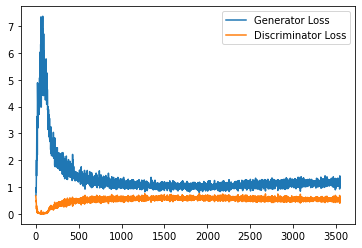

Step 71500: Generator loss: 1.1550320966243743, discriminator loss: 0.5430716522336007


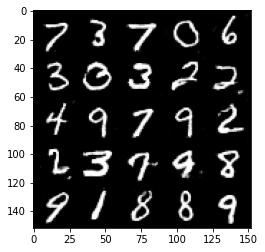

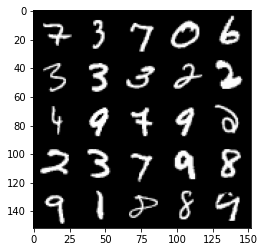

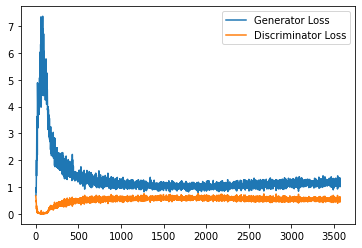

Step 72000: Generator loss: 1.149561177611351, discriminator loss: 0.5600011382699013


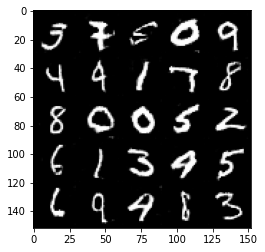

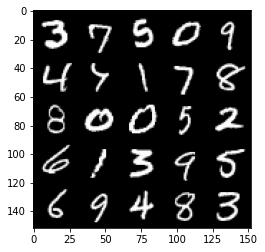

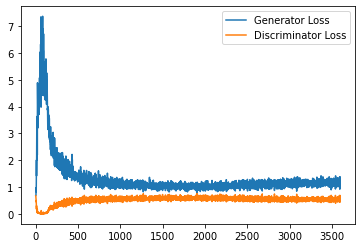

Step 72500: Generator loss: 1.146986431479454, discriminator loss: 0.5393384464383125


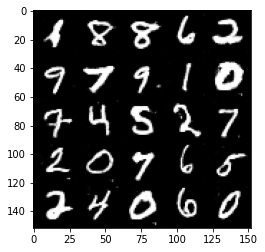

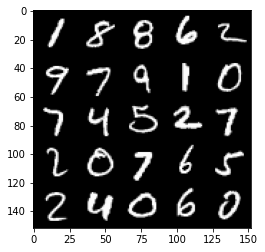

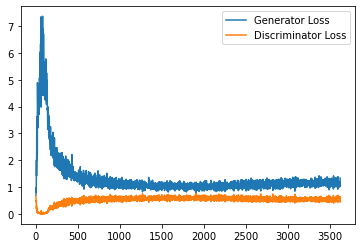

Step 73000: Generator loss: 1.1380002393722535, discriminator loss: 0.5464237260222435


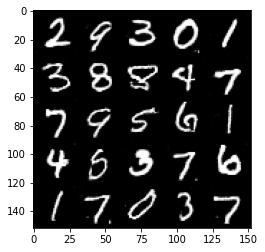

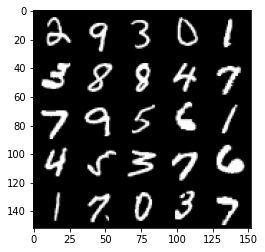

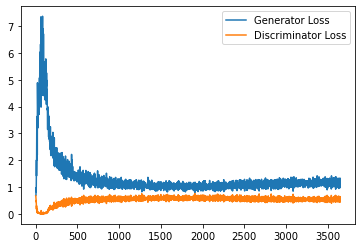

Step 73500: Generator loss: 1.1369947518110275, discriminator loss: 0.54814201182127


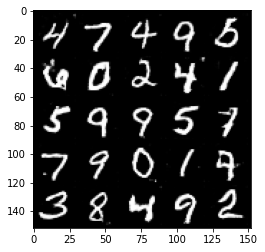

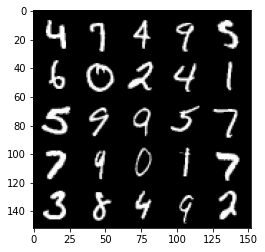

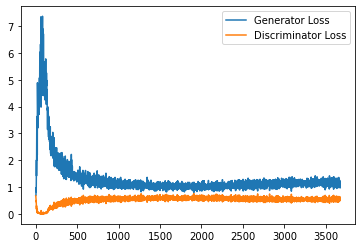

Step 74000: Generator loss: 1.148010682106018, discriminator loss: 0.5457557706832886


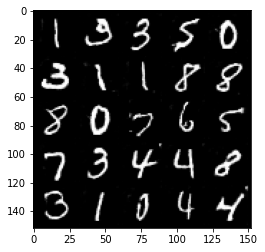

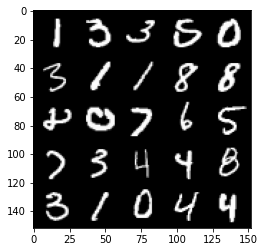

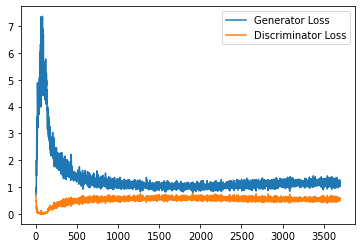

Step 74500: Generator loss: 1.1487349807024, discriminator loss: 0.5488042867779732


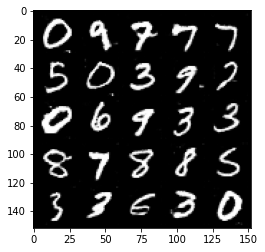

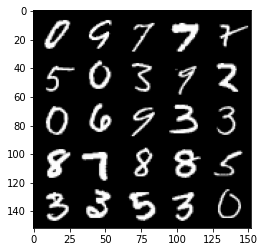

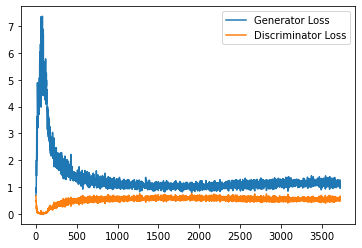

Step 75000: Generator loss: 1.162834963321686, discriminator loss: 0.5543371039032936


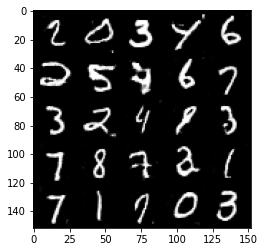

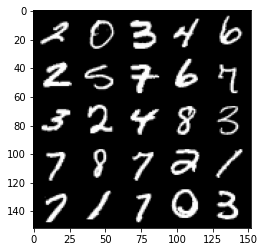

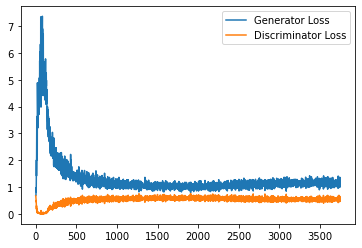

Step 75500: Generator loss: 1.1322837623357773, discriminator loss: 0.5559560926556587


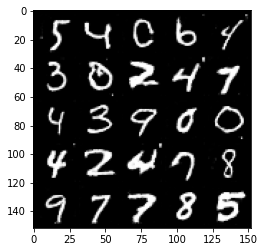

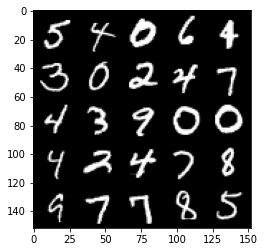

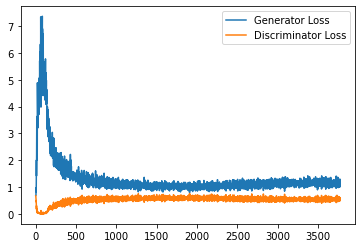

Step 76000: Generator loss: 1.142461379647255, discriminator loss: 0.5464053118228912


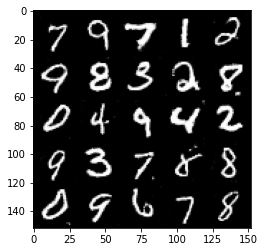

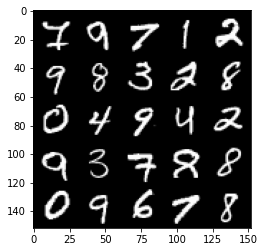

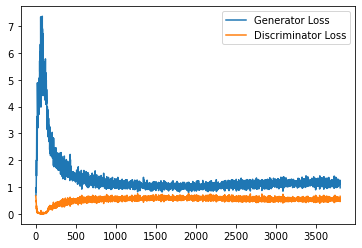

Step 76500: Generator loss: 1.1539592958688736, discriminator loss: 0.5486169915795326


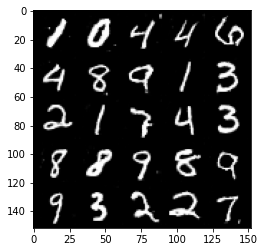

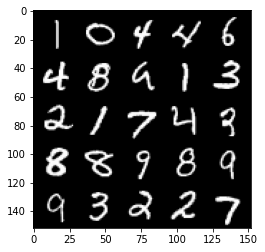

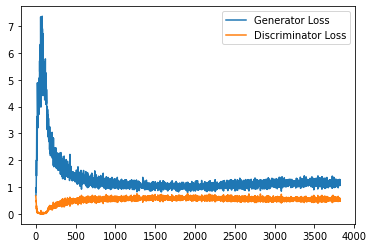

Step 77000: Generator loss: 1.1545900942087173, discriminator loss: 0.5495521848797799


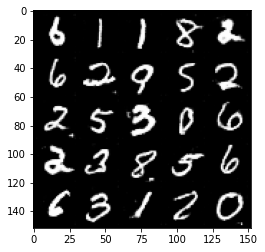

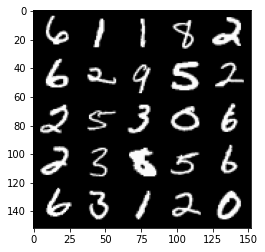

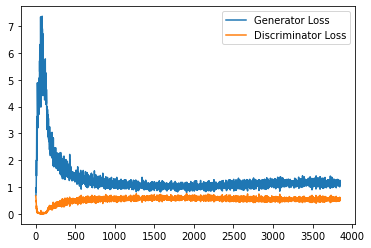

Step 77500: Generator loss: 1.1313590803146363, discriminator loss: 0.5527514112591744


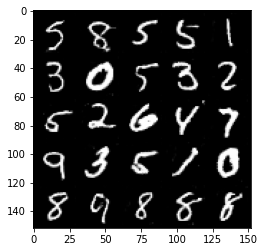

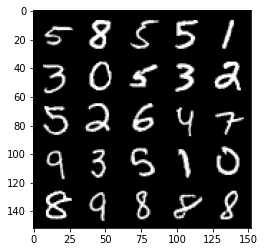

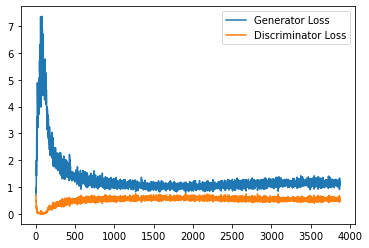

Step 78000: Generator loss: 1.1521569406986236, discriminator loss: 0.5447996307015419


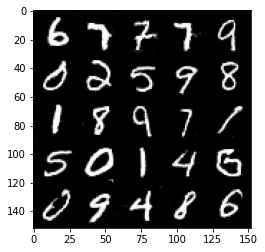

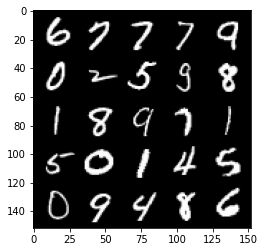

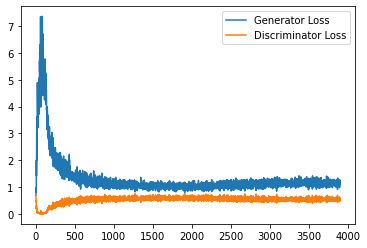

Step 78500: Generator loss: 1.1345744246244431, discriminator loss: 0.5530818237066268


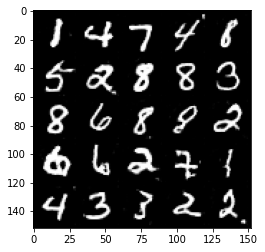

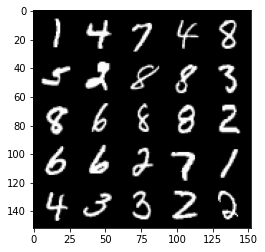

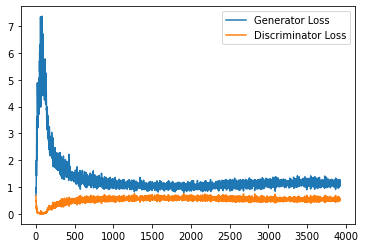

Step 79000: Generator loss: 1.1318743472099304, discriminator loss: 0.5518017709851265


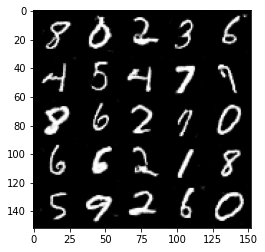

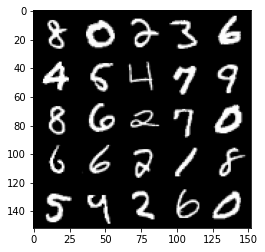

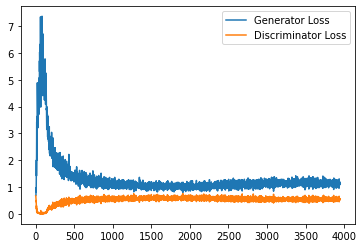

Step 79500: Generator loss: 1.1406454373598098, discriminator loss: 0.5569579856991768


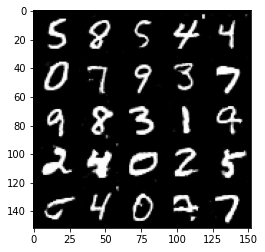

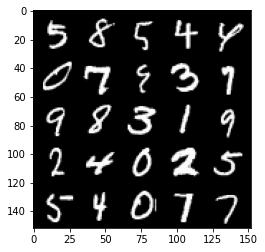

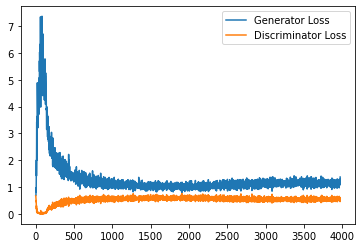

Step 80000: Generator loss: 1.1582996504306793, discriminator loss: 0.5586748231053352


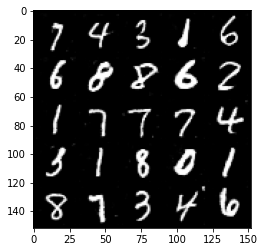

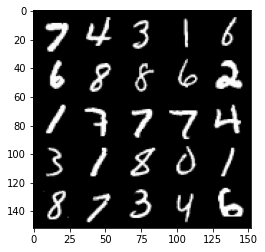

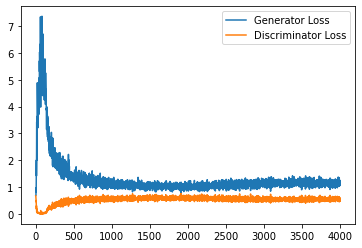

Step 80500: Generator loss: 1.1221549261808395, discriminator loss: 0.5569675395488739


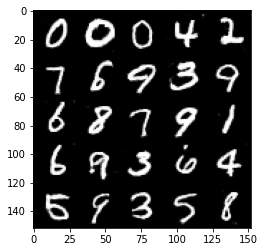

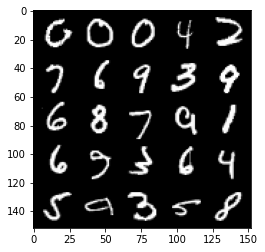

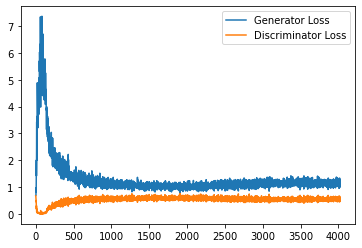

Step 81000: Generator loss: 1.1365882779359817, discriminator loss: 0.5458116739988327


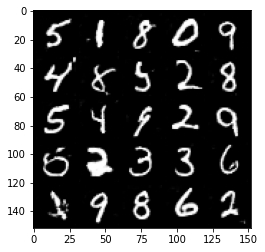

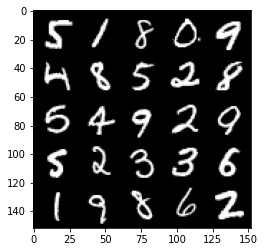

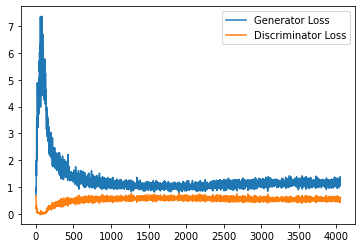

Step 81500: Generator loss: 1.1620273962020875, discriminator loss: 0.5529828748703003


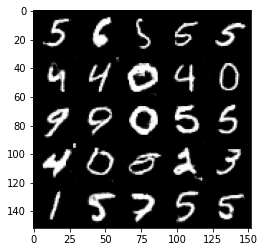

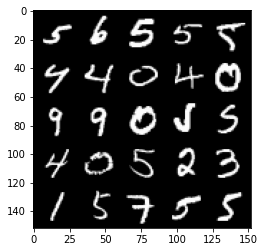

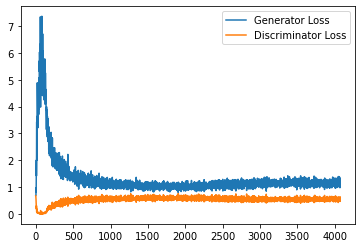

Step 82000: Generator loss: 1.160097025513649, discriminator loss: 0.5512195871472358


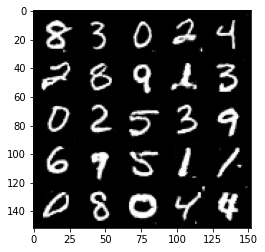

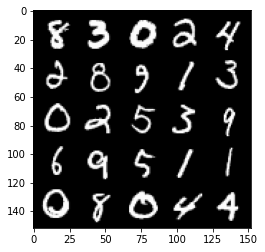

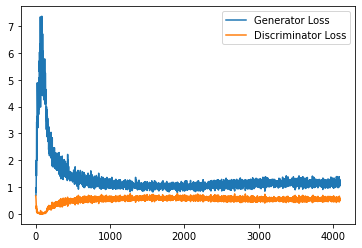

Step 82500: Generator loss: 1.1330167750120164, discriminator loss: 0.5560015362501144


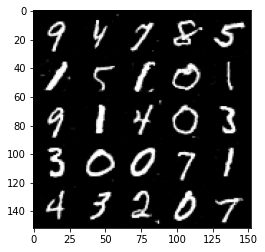

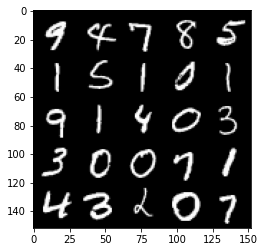

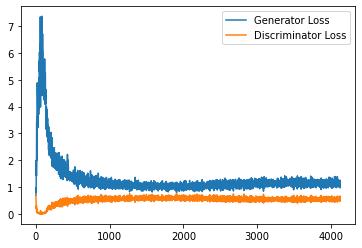

Step 83000: Generator loss: 1.1338121592998505, discriminator loss: 0.5581086692214012


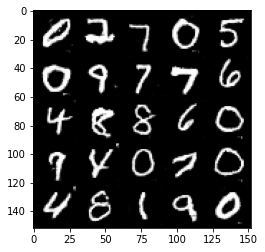

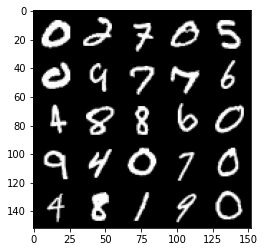

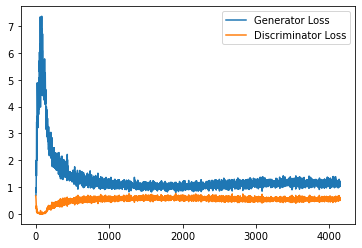

Step 83500: Generator loss: 1.127476661801338, discriminator loss: 0.5523323483467102


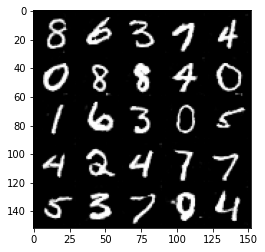

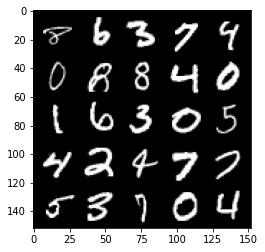

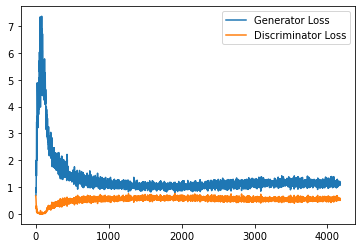

Step 84000: Generator loss: 1.1657125984430312, discriminator loss: 0.5573066071271896


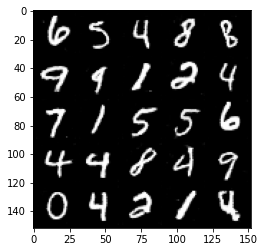

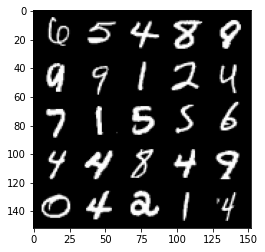

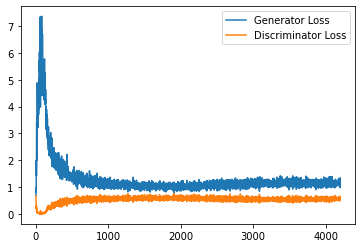

Step 84500: Generator loss: 1.1116200877428055, discriminator loss: 0.5656800104379653


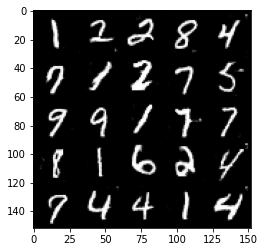

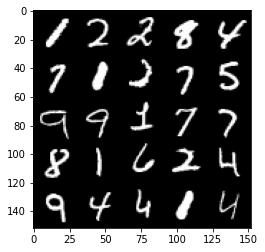

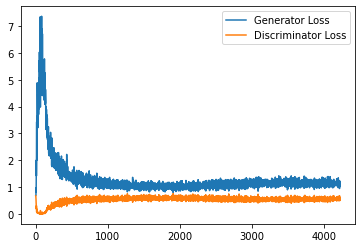

Step 85000: Generator loss: 1.1298451297283172, discriminator loss: 0.5586426573395729


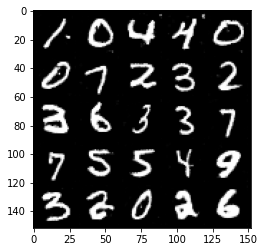

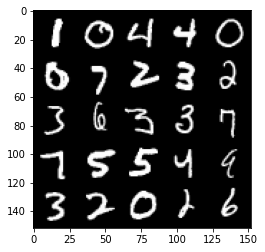

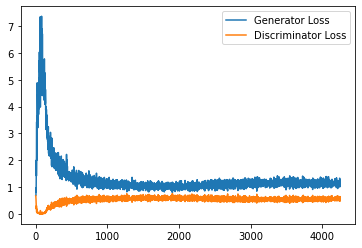

Step 85500: Generator loss: 1.143029062628746, discriminator loss: 0.5610608578920364


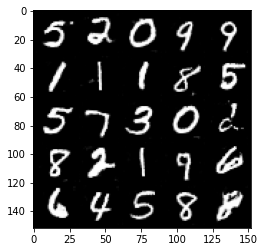

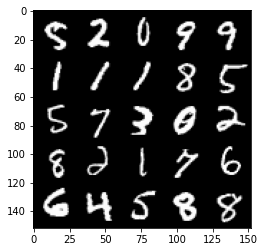

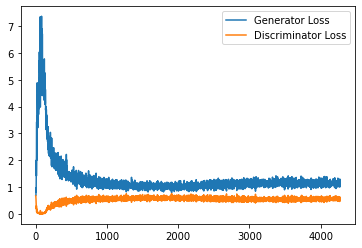

Step 86000: Generator loss: 1.126158900618553, discriminator loss: 0.566448710501194


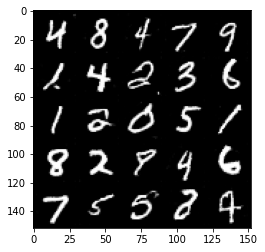

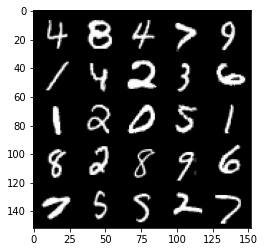

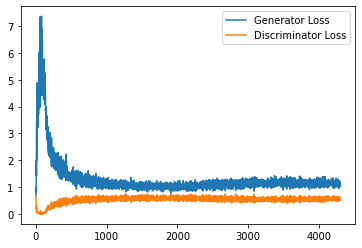

Step 86500: Generator loss: 1.124291718363762, discriminator loss: 0.5650318244099617


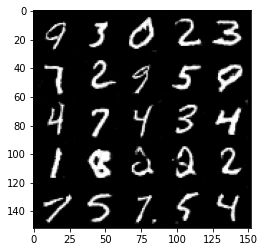

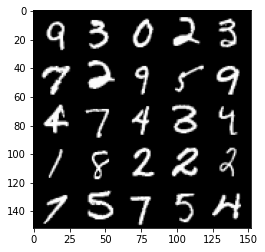

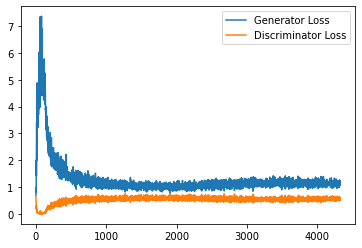

Step 87000: Generator loss: 1.1277329126596451, discriminator loss: 0.5640031415820121


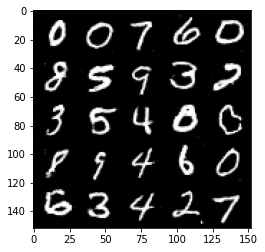

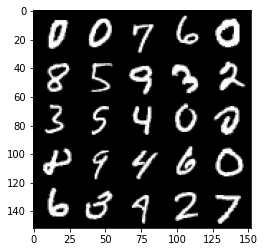

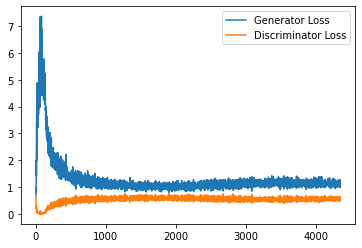

Step 87500: Generator loss: 1.109017132997513, discriminator loss: 0.5660122246742249


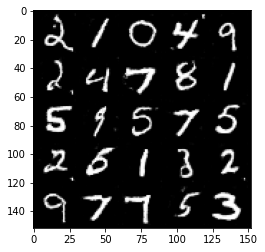

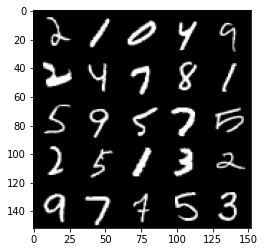

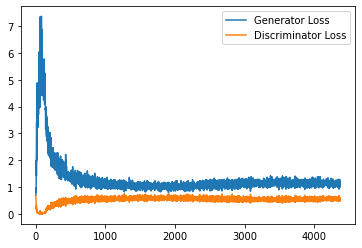

Step 88000: Generator loss: 1.106390266418457, discriminator loss: 0.5632156505584717


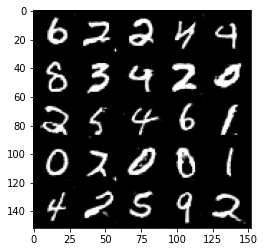

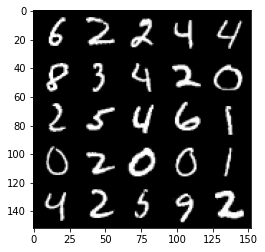

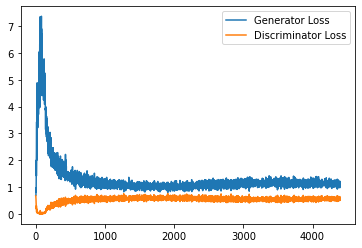

Step 88500: Generator loss: 1.122096969127655, discriminator loss: 0.5717631094455718


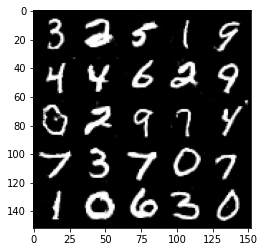

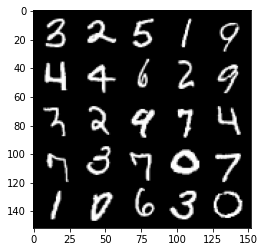

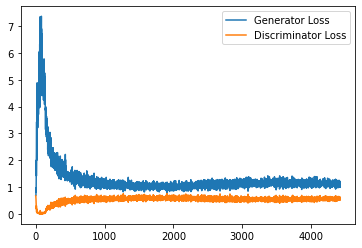

Step 89000: Generator loss: 1.109865976333618, discriminator loss: 0.567492740213871


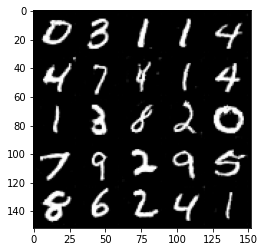

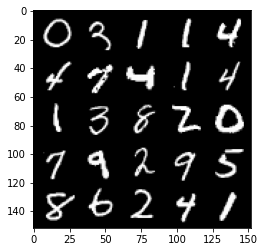

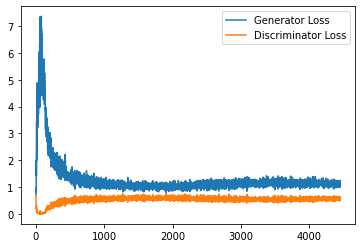

Step 89500: Generator loss: 1.1039522578716279, discriminator loss: 0.5829751195311547


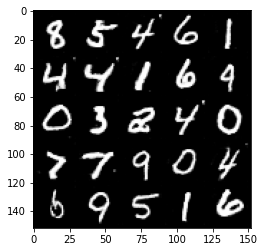

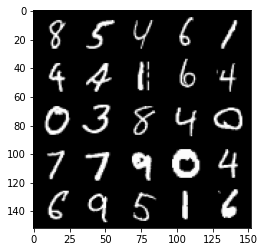

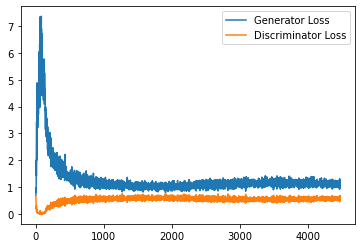

Step 90000: Generator loss: 1.1258308477401733, discriminator loss: 0.5665325939059257


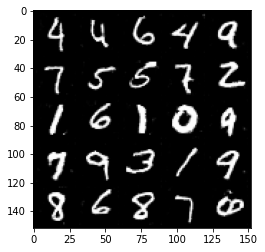

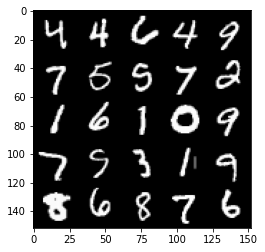

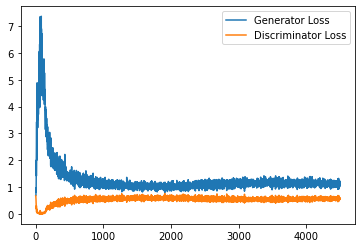

Step 90500: Generator loss: 1.1131588847637177, discriminator loss: 0.5688352143764496


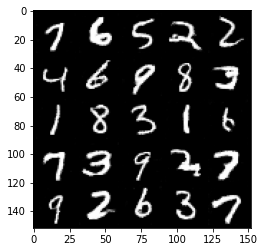

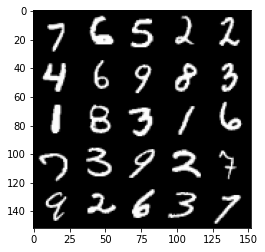

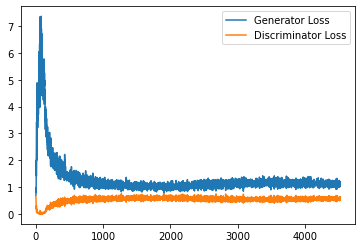

Step 91000: Generator loss: 1.1242377815246583, discriminator loss: 0.5639669205546379


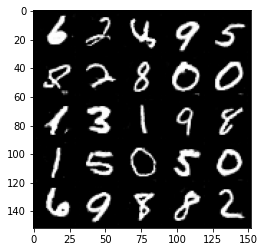

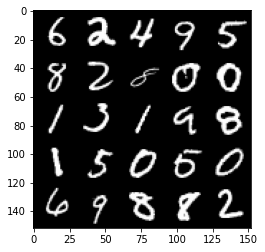

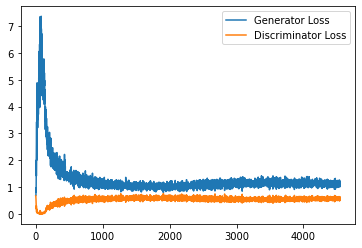

Step 91500: Generator loss: 1.0918175539970398, discriminator loss: 0.5691139941215515


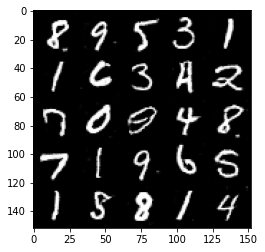

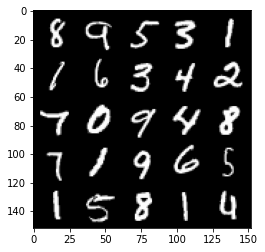

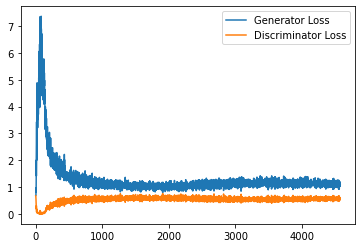

Step 92000: Generator loss: 1.1260383754968644, discriminator loss: 0.5701671448946


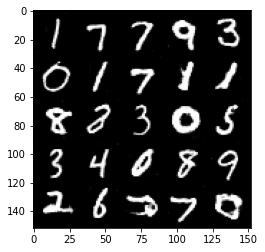

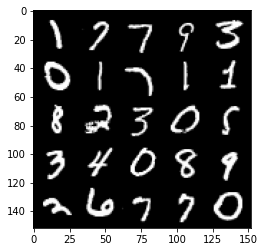

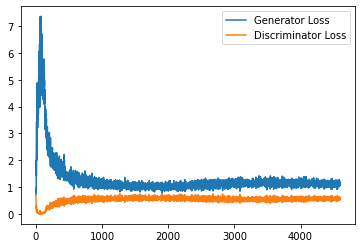

Step 92500: Generator loss: 1.094978266119957, discriminator loss: 0.5729986318349838


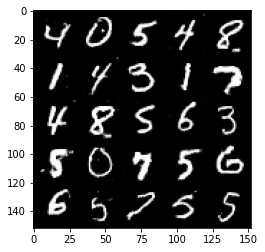

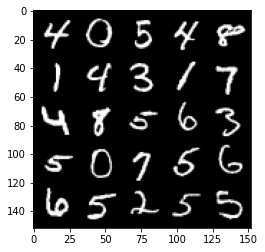

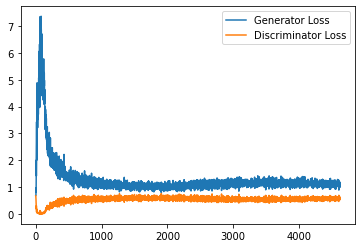

Step 93000: Generator loss: 1.1128704917430878, discriminator loss: 0.5676137753129006


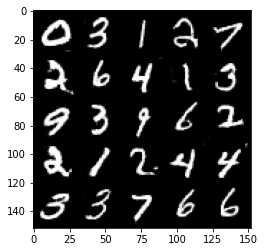

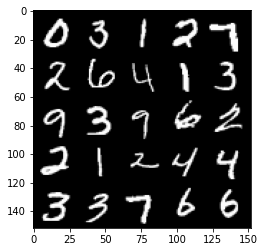

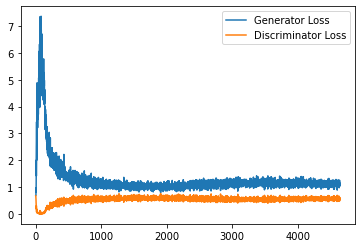

Step 93500: Generator loss: 1.0968914257287978, discriminator loss: 0.5745183480978012


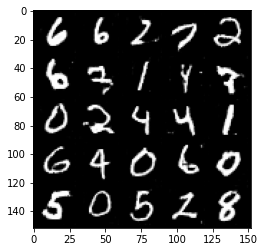

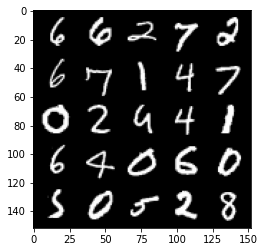

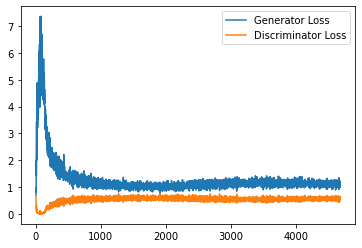

In [18]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(x=fake_noise, y=one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(x=fake, y=image_one_hot_labels)
        real_image_and_labels = combine_vectors(x=real, y=image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [19]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

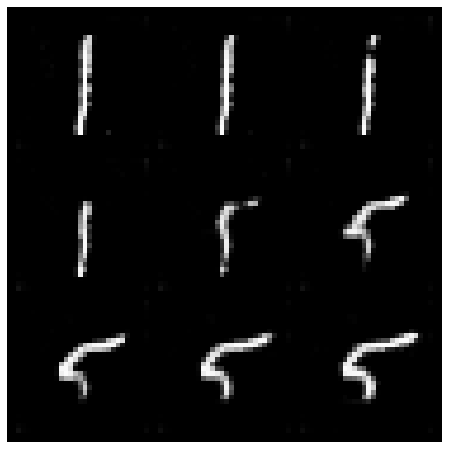

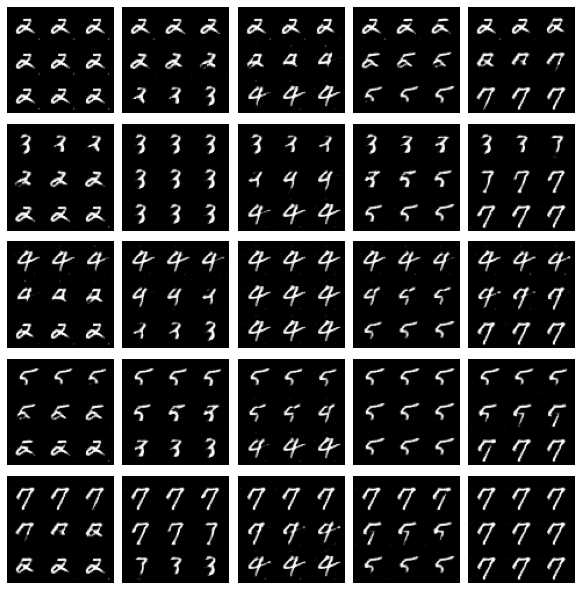

In [20]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()